# Working with the datasets from which we already know the probability of the outcomes

In [1]:
import numpy as np
import pandas as pd
from scipy.special import expit   # the sigmoid function
from sklearn.linear_model import LogisticRegression
from sklearn.calibration import calibration_curve
import matplotlib.pyplot as plt
import matplotlib as mpl

**The *Calibration Curve* (first plot)**  
* **What it shows:**
  You take your predicted probabilities $\hat s(x_i)$, sort them into (say) 10 equal-width bins, and in each bin you plot

  $$
    \bigl(\text{mean predicted probability in the bin},\;\text{observed fraction of }D=1\text{ in that bin}\bigr).
  $$
* **Why it’s useful:**
  This is exactly what you can do on *real* data (where you only have 0/1 outcomes).  If your points lie on the 45° line, it means “among all the examples I said 0.6, about 60% actually had $D=1$.”  It’s a binned, empirical check of calibration.


**The *Predicted vs. True Probability Scatter* (second plot)**  
* **What it shows:**
  Since this is *synthetic* data, you actually know the “ground-truth” $p_i=\sigma(\eta_i)$ that generated each label.  Here each dot is one $(p_i,\;\hat s(x_i))$ pair, so you get a full scatter of predictions against their true values.
* **Why it’s useful:**
  It gives you a pointwise, high-resolution picture of how close $\hat s$ is to the actual DGP probability.  You can literally see the spread around the diagonal and even compute an MSE $\frac1n\sum (p_i-\hat s_i)^2$.  You can only do this when you’re in a simulation and know the true $p_i$.


In short, the *Calibration curve* is a *binned* check of $\hat s$ vs. observed frequency of $D$, usable on real data. And the *Scatter vs. true* is a *pointwise* check of $\hat s$ vs. the *known* $p$ in your synthetic experiment.


## Dataset similar to `make_circles` but knowing the real probabilities

* **Features**:
  $X_1,X_2\sim N(0,1)$.

* **Probability**:

  $$
    p_i = \frac{1}{1 + \exp\bigl[-\alpha\,(X_{1,i}^2 + X_{2,i}^2 - r_0)\bigr]}
    \quad\text{with}\ \alpha=5.0,\ r_0=1.0.
  $$

* **Outcome**:
  $y_i\sim\mathrm{Bernoulli}(p_i)$.

The scatter plot above shows the two “classes” (inner circle vs. outer) generated by sampling points from those ring‐shaped probabilities.


In our synthetic-circle generator, we set

$$
p_i = \sigma\bigl(\alpha\,(X_{1,i}^2 + X_{2,i}^2 - r_0)\bigr)
$$

where $\sigma(z)=1/(1+e^{-z})$.

* **$r_0$** is the “radius threshold.”  Since $X_1^2+X_2^2$ is the squared distance from the origin, when $X_1^2+X_2^2 = r_0$ the argument to the sigmoid is zero, so $p_i = 0.5$.  Points *inside* that circle ($<r_0$) get $p<0.5$, points *outside* ($>r_0$) get $p>0.5$.

* **$\alpha$** controls the **steepness** of the transition from low to high probability.

  * If $\alpha$ is very large, the sigmoid becomes almost a step at radius $\sqrt{r_0}$: points just inside get $p\approx0$ and just outside get $p\approx1$.
  * If $\alpha$ is small, the transition is more gradual, so you’ll see a fuzzy band around the circle where $p$ moves smoothly from 0 toward 1.

By tweaking $r_0$ you move the circle’s radius, and by tweaking $\alpha$ you make the “ring boundary” sharper or softer.


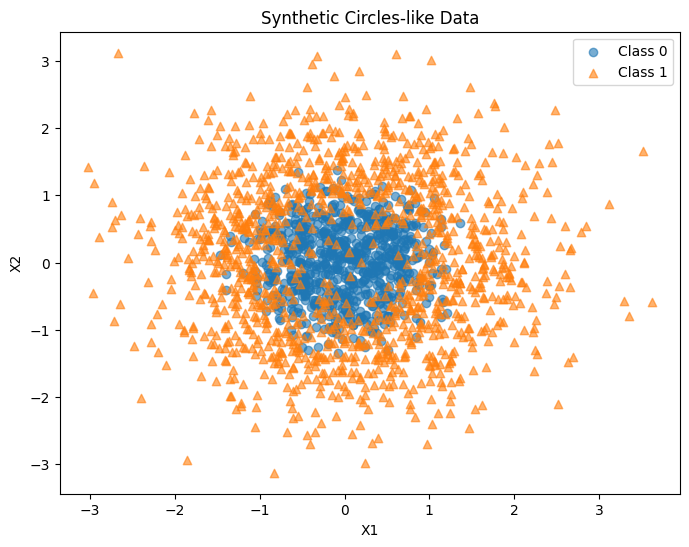

In [2]:
import numpy as np
import matplotlib.pyplot as plt

# 1) PARAMETERS
n = 2000
alpha = 3.0  # controls sharpness of the circle boundary
r0 = 1    # target radius

# 2) SIMULATE FEATURES
X1 = np.random.randn(n)
X2 = np.random.randn(n)
r2 = X1**2 + X2**2

# 3) DEFINE TRUE PROBABILITIES USING A SIGMOID ON r^2 - r0
p = 1 / (1 + np.exp(-alpha * (r2 - r0)))

# 4) SAMPLE OUTCOME y ~ Bernoulli(p)
y = np.random.binomial(1, p)

# 5) SCATTER PLOT
classes = np.unique(y)
plt.figure(figsize=(8,6))
for cls, marker in zip(classes, ['o','^']):
    plt.scatter(
        X1[y==cls], 
        X2[y==cls], 
        alpha=0.6, 
        marker=marker, 
        label=f'Class {int(cls)}')

plt.legend()
plt.xlabel('X1')
plt.ylabel('X2')
plt.title('Synthetic Circles-like Data')
plt.show()


In [3]:
(y.sum()) / 2000

0.628

In [4]:
# Full dataset
X = np.column_stack((X1, X2))   # now X has shape (n,2)
# extend X with that third column
X_ext = np.column_stack((X, r2))  # shape (n,3)
X_ext

array([[-1.69375409,  0.16770199,  2.89692689],
       [ 1.53381368,  0.11459219,  2.36571579],
       [ 0.05061161,  0.77191934,  0.598421  ],
       ...,
       [-0.2370413 ,  0.4418602 ,  0.25142902],
       [-1.37406589,  1.31764703,  3.62425075],
       [-1.53400115,  0.58266433,  2.69265725]])

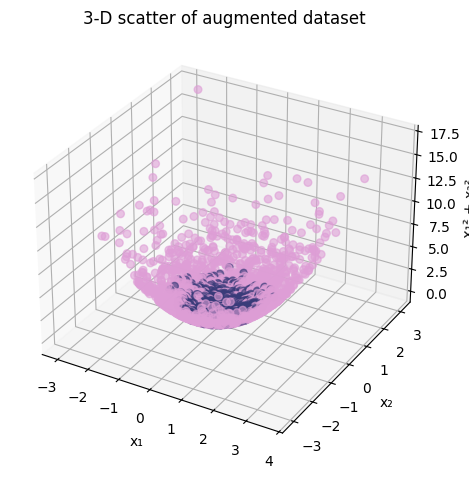

In [5]:
fig = plt.figure()
ax = fig.add_subplot(projection='3d')

# X_ext  → shape (n_samples, 3)
# y      → 1-D array of class labels you got from make_blobs
ax.scatter(X_ext[:, 0], X_ext[:, 1], X_ext[:, 2], c=y, alpha=0.6, cmap=plt.cm.tab20b, s=30)

ax.set_xlabel("x₁")
ax.set_ylabel("x₂")
ax.set_zlabel("x₁² + x₂²")
plt.title("3-D scatter of augmented dataset")
plt.tight_layout()
plt.show()

In [6]:
import os, sys, importlib.util

# 1) Where Jupyter is currently running:
cwd = os.getcwd()
print("Notebook cwd:", cwd)

# 2) Compute the folder above (your project root):
project_root = os.path.abspath(os.path.join(cwd, os.pardir))
print("Project root:", project_root)
print("→ Contains:", os.listdir(project_root))

# 3) Inject it onto sys.path (highest priority):
if project_root not in sys.path:
    sys.path.insert(0, project_root)
print("After hack, sys.path[0]:", sys.path[0])

# 4) Confirm Python can now see lmt_pkg:
print("After hack, spec(lmt_pkg):", importlib.util.find_spec("lmt_pkg"))

from lmt_pkg import lmt_final_implementation as lmt
from lmt_pkg import calibration_functions as calibration
from lmt_pkg import logitboost_j_implementation as logitboost


Notebook cwd: c:\Users\allis\Desktop\MITACS\LMT-calibration\Construction and tests
Project root: c:\Users\allis\Desktop\MITACS\LMT-calibration
→ Contains: ['.git', 'Calibration testing', 'Construction and tests', 'Documentation', 'lmt_pkg', 'Papers', 'README.md']
After hack, sys.path[0]: c:\Users\allis\Desktop\MITACS\LMT-calibration
After hack, spec(lmt_pkg): ModuleSpec(name='lmt_pkg', loader=<_frozen_importlib_external.SourceFileLoader object at 0x000002482F2296C0>, origin='c:\\Users\\allis\\Desktop\\MITACS\\LMT-calibration\\lmt_pkg\\__init__.py', submodule_search_locations=['c:\\Users\\allis\\Desktop\\MITACS\\LMT-calibration\\lmt_pkg'])


In [7]:
import numpy as np
import matplotlib.pyplot as plt
#import logitboost_j_implementation as logitboost
#import calibration_functions as calibration
from sklearn.model_selection import train_test_split
from sklearn.datasets import make_circles
from sklearn.metrics import accuracy_score, roc_auc_score, log_loss
#import lmt_final_implementation as lmt
# from lmt_pkg import lmt_final_implementation as lmt
# from lmt_pkg import calibration_functions as calibration
# from lmt_pkg import logitboost_j_implementation as logitboost
from sklearn import tree

In [8]:
# Split the dataset into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X_ext, y, test_size=0.3, random_state=42)

### LogitBoost *J* classes

In [9]:
# Fit the LogitBoost model
learners1, J1 = logitboost.logitboost_fit(X_train[:,:2], y_train, n_estimators=500)

# Predict using the fitted model on test set
y_pred1 = logitboost.logitboost_predict(X_test[:,:2], learners1, J1)
y_proba1 = logitboost.logitboost_predict_proba(X_test[:,:2], learners1, J1)

# Evaluate the model
acc1 = accuracy_score(y_test, y_pred1)
roc1 = roc_auc_score(y_test, y_proba1[:, 1])
log_loss1 = log_loss(y_test, y_proba1)

# Print results for original make_circles
print(f"Log-loss on original make_circles: {log_loss1:.4f}")
print(f"Accuracy on original make_circles: {acc1:.4f}")
print(f"ROC AUC on original make_circles: {roc1:.4f}")

Log-loss on original make_circles: 0.6540
Accuracy on original make_circles: 0.6383
ROC AUC on original make_circles: 0.5331


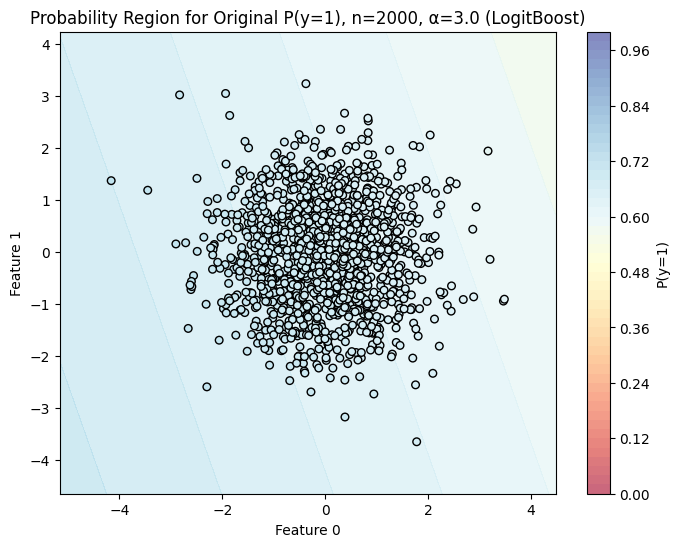

In [10]:
ax, contour = logitboost.plot_probability_region_logit(
    X_train[:,:2], y_train,
    learners1, J1,
    feature_pair=(0,1),
    prob_class=1,
    fill_value="mean",
    h=0.02,
    cmap="RdYlBu",
    title=f"Probability Region for Original P(y=1), n={n}, α={alpha} (LogitBoost)",
)
plt.show()

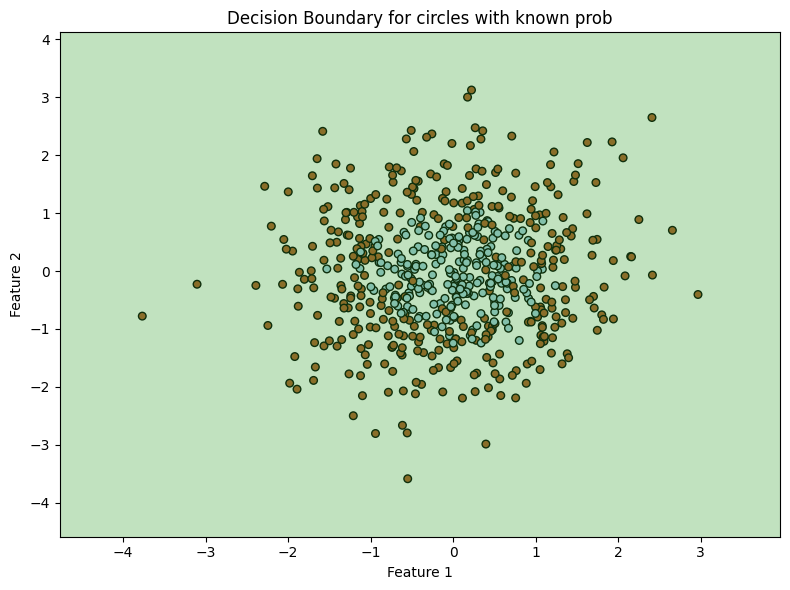

In [11]:
logitboost.plot_decision_boundary(X_test[:,:2], y_test, learners1, J1,
                       title="Decision Boundary for circles with known prob")

In [12]:
# Fit the LogitBoost model
learners2, J2 = logitboost.logitboost_fit(X_train, y_train, n_estimators=500)

# Predict using the fitted model on test set
y_pred2 = logitboost.logitboost_predict(X_test, learners2, J2)
y_proba2 = logitboost.logitboost_predict_proba(X_test, learners2, J2)

# Evaluate the model
acc2 = accuracy_score(y_test, y_pred2)
log_loss2 = log_loss(y_test, y_proba2)
roc2 = roc_auc_score(y_test, y_proba2[:, 1])

# Print results for extended make_circles
print(f"Log-loss on extended make_circles: {log_loss2:.4f}")
print(f"Accuracy on extended make_circles: {acc2:.4f}")
print(f"ROC AUC on extended make_circles: {roc2:.4f}")

Log-loss on extended make_circles: 0.2949
Accuracy on extended make_circles: 0.8633
ROC AUC on extended make_circles: 0.9407


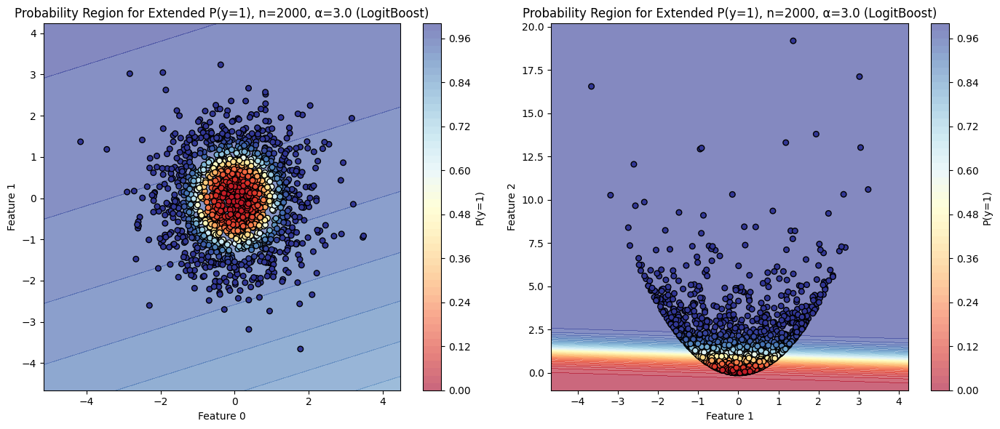

In [13]:
# Subplots to show the probability regions for both pairs of features
fig, ax = plt.subplots(1, 2, figsize=(14, 6))

# For feature pair (0, 1)
# Put it in the first subplot
_, contour1 = logitboost.plot_probability_region_logit(
    X_train, y_train,
    learners2, J2,
    feature_pair=(0,1),
    prob_class=1,
    fill_value="mean",
    h=0.02,
    cmap="RdYlBu",
    title=f"Probability Region for Extended P(y=1), n={n}, α={alpha} (LogitBoost)",
    ax=ax[0]
)

# For feature pair (1, 2)
_, contour2 = logitboost.plot_probability_region_logit(
    X_train, y_train,
    learners2, J2,
    feature_pair=(1,2),
    prob_class=1,
    fill_value="mean",
    h=0.02,
    cmap="RdYlBu",
    title=f"Probability Region for Extended P(y=1), n={n}, α={alpha} (LogitBoost)",
    ax=ax[1]
)
plt.tight_layout()
plt.show()

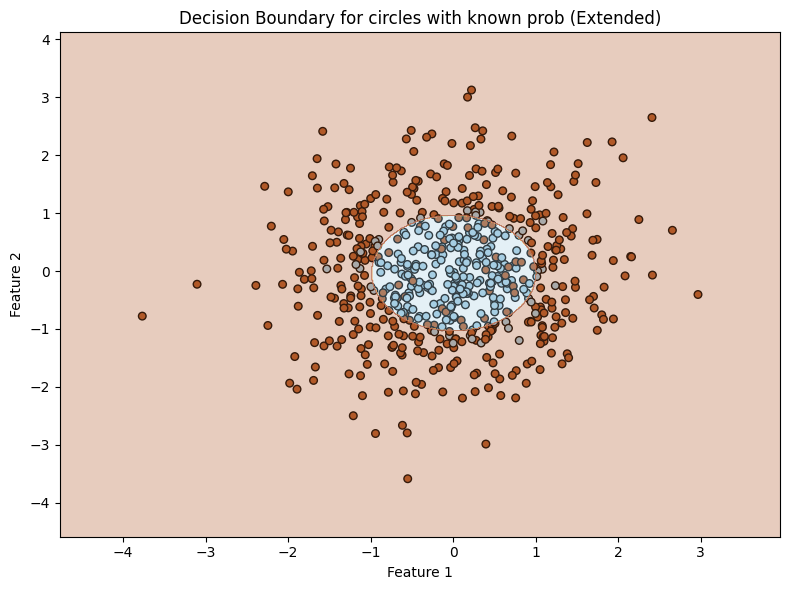

In [14]:
logitboost.plot_decision_boundary(X_test, y_test, learners2, J2,
                       title="Decision Boundary for circles with known prob (Extended)",)

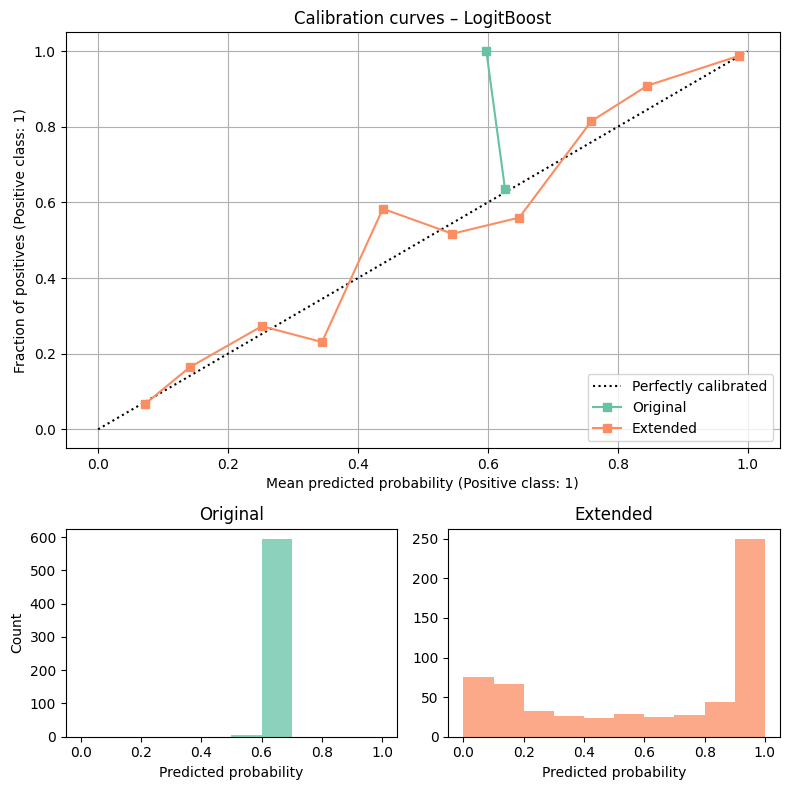

In [15]:
from sklearn.calibration import CalibrationDisplay
from matplotlib.gridspec import GridSpec
# import expit function
from scipy.special import expit
# --- 1) recover true p_i on the test set --------------------
# assuming X_test is shape (n_test,2) for the original features
# and your true probabilities only depend on x1^2 + x2^2:
r2_test = X_test[:,0]**2 + X_test[:,1]**2
p_true  = expit(alpha * (r2_test - r0))

# --- 2) calibration curves (10 bins) ------------------------
# Get class-probability estimates for each model
#  -> keep only the probability of the positive class (column 1)
proba_orig = logitboost.logitboost_predict_proba(X_test[:,:2], learners1, J1)[:, 1]
proba_ext  = logitboost.logitboost_predict_proba(X_test, learners2, J2)[:, 1]

fig = plt.figure(figsize=(8, 8))
gs  = GridSpec(nrows=2, ncols=2, height_ratios=[2, 1])

ax_curve = fig.add_subplot(gs[0, :])                 # big panel for the curves
ax_hist1 = fig.add_subplot(gs[1, 0])                 # histogram – model 1
ax_hist2 = fig.add_subplot(gs[1, 1])                 # histogram – model 2
colors   = plt.get_cmap("Set2")

# ―― Curve for the ORIGINAL data ――
CalibrationDisplay.from_predictions(
    y_test,           # true labels (binary, 0 / 1)
    proba_orig,       # predicted prob of class 1
    n_bins=10,
    name="Original",
    ax=ax_curve,
    color=colors(0),
)

# ―― Curve for the EXTENDED data ――
CalibrationDisplay.from_predictions(
    y_test,
    proba_ext,
    n_bins=10,
    name="Extended",
    ax=ax_curve,
    color=colors(1),
)

ax_curve.set_title("Calibration curves – LogitBoost")
ax_curve.grid(True)
ax_hist1.hist(proba_orig, bins=10, range=(0, 1),
              color=colors(0), alpha=0.75)
ax_hist1.set(title="Original", xlabel="Predicted probability", ylabel="Count")

ax_hist2.hist(proba_ext,  bins=10, range=(0, 1),
              color=colors(1), alpha=0.75)
ax_hist2.set(title="Extended", xlabel="Predicted probability")

fig.tight_layout()
plt.show()

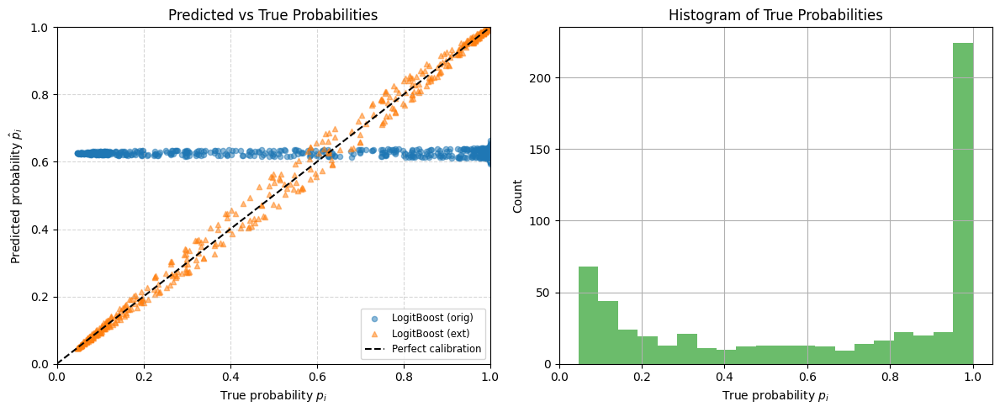

In [16]:
calibration.plot_pred_vs_true(
    models={
        'LogitBoost (orig)': (learners1, J1),
        'LogitBoost (ext)': (learners2, J2),
    },
    p_true=p_true,
    X_test=X_test,
    model_type='logitboost'
)

C:\Users\allis\AppData\Local\Temp\ipykernel_7224\3930864916.py:12: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = mpl.cm.get_cmap('Spectral', n_quantiles)


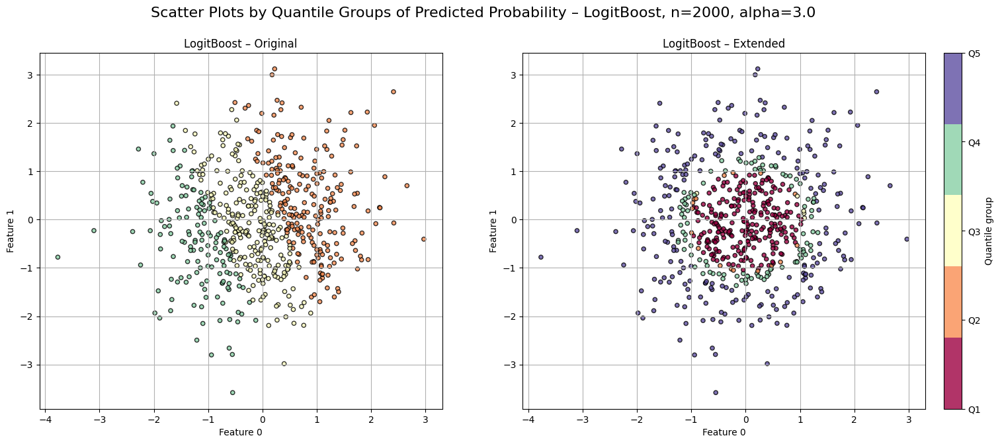

In [17]:
# import matplotlib.pyplot as plt
import matplotlib as mpl
# 1. Get model probabilities
y_proba1 = logitboost.logitboost_predict_proba(X_test[:, :2], learners1, J1)[:, 1]
y_proba2 = logitboost.logitboost_predict_proba(X_test, learners2, J2)[:, 1]

# 2. Define consistent binning, norm, and colormap
n_quantiles = 5
all_probs = np.concatenate([y_proba1, y_proba2])
q_edges = np.quantile(all_probs, np.linspace(0, 1, n_quantiles + 1))
norm = mpl.colors.Normalize(vmin=0, vmax=n_quantiles - 1)
cmap = mpl.cm.get_cmap('Spectral', n_quantiles)

# 3. Create subplots
fig, axes = plt.subplots(1, 2, figsize=(18, 7))

# 4. Plot each scatter with shared binning
scatter1 = calibration.plot_scatter_by_quantile(
    X_test[:, :2],
    y_proba1,
    n_quantiles=n_quantiles,
    title="LogitBoost – Original",
    ax=axes[0],
    cmap=cmap,
    norm=norm,
    q_edges=q_edges
)

scatter2 = calibration.plot_scatter_by_quantile(
    X_test[:, :2],
    y_proba2,
    n_quantiles=n_quantiles,
    title="LogitBoost – Extended",
    ax=axes[1],
    cmap=cmap,
    norm=norm,
    q_edges=q_edges
)

# 5. Shared colorbar
cbar = fig.colorbar(scatter2, ax=axes, orientation="vertical", fraction=0.02, pad=0.02)
cbar.set_label("Quantile group")
cbar.set_ticks(range(n_quantiles))
cbar.set_ticklabels([f"Q{i + 1}" for i in range(n_quantiles)])

fig.suptitle(f"Scatter Plots by Quantile Groups of Predicted Probability – LogitBoost, n={n}, alpha={alpha} ", fontsize=16)
plt.show()



### Decision Trees $C4.5$

Shallow Tree (No Pruning) - Accuracy: 0.6567, AUC: 0.7199, Log Loss: 0.5956
Regular Tree (No Pruning) - Accuracy: 0.8467, AUC: 0.9063, Log Loss: 1.8276
Overfit Tree (No Pruning) - Accuracy: 0.8150, AUC: 0.8072, Log Loss: 6.6681
Regular Tree (With Pruning) - Accuracy: 0.8567, AUC: 0.9159, Log Loss: 0.6637


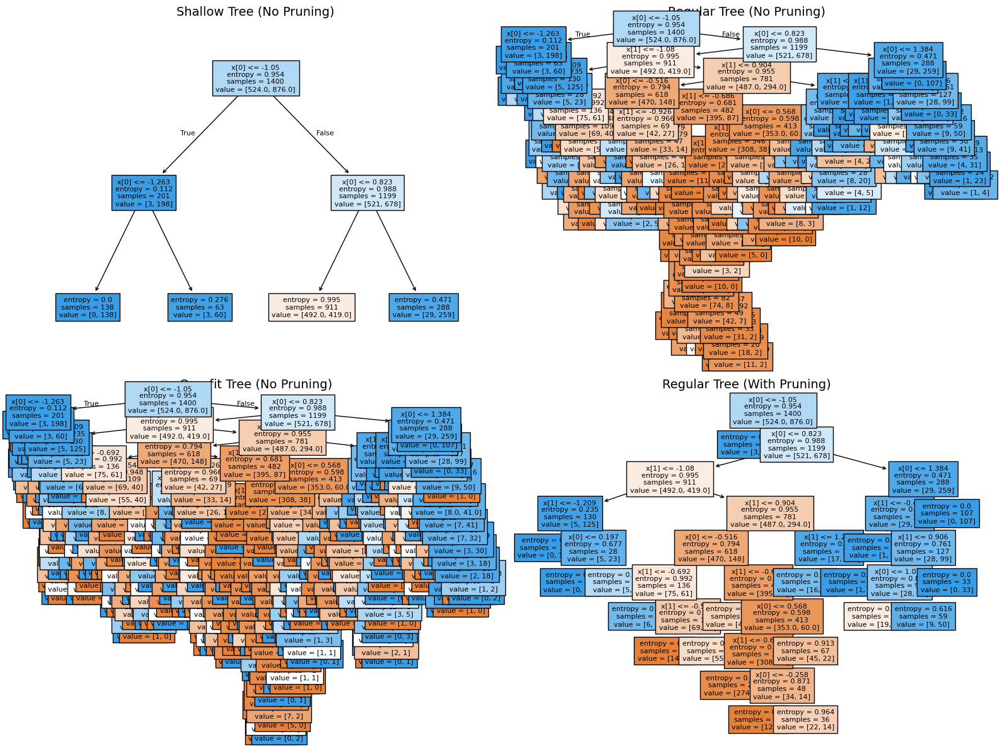

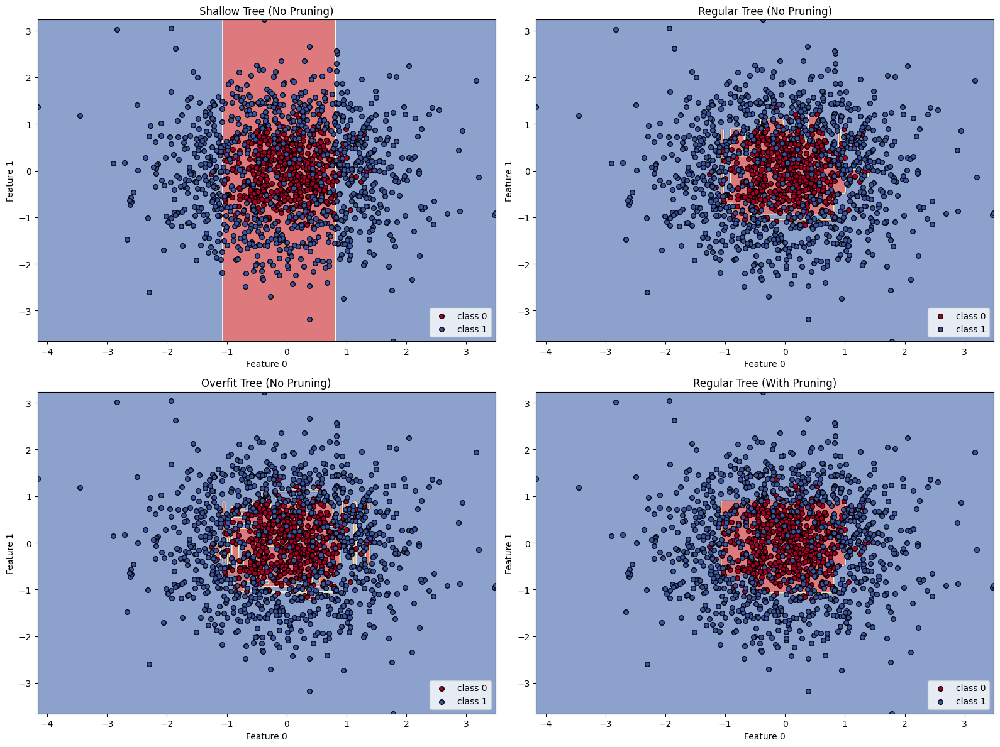

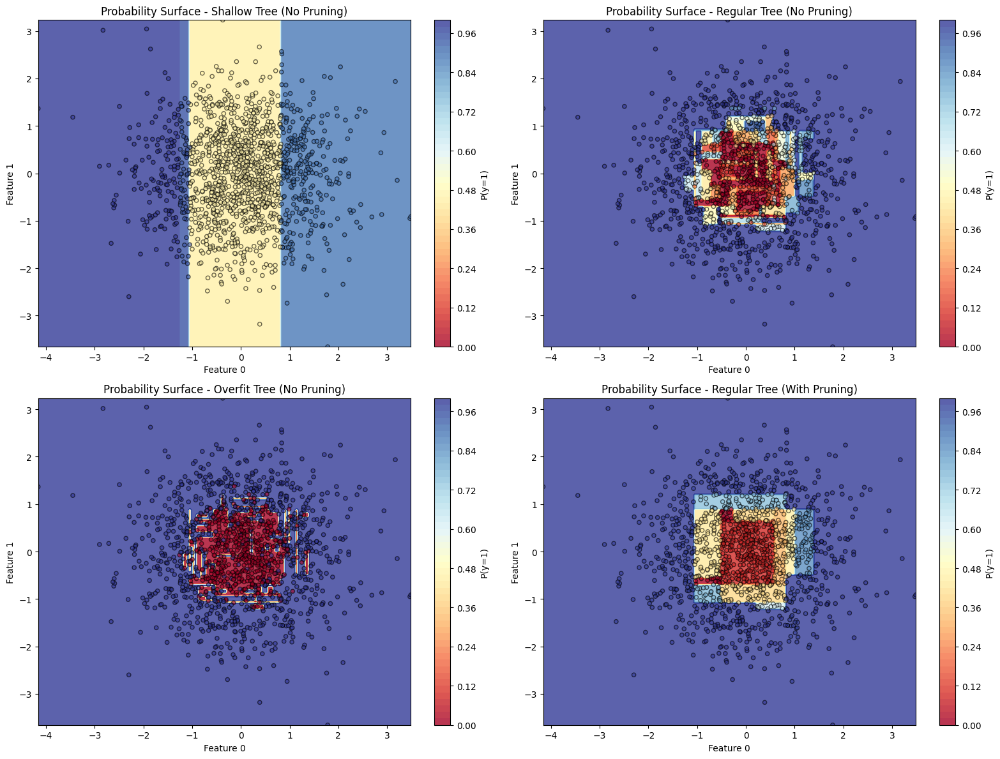

In [18]:
lmt.compare_tree_variants(X_train[:,:2], X_test[:,:2], y_train, y_test, lmt, decision=True, prob_surf=True, feature_pair=(0,1))

Shallow Tree (No Pruning) - Accuracy: 0.8567, AUC: 0.9236, Log Loss: 0.3207
Regular Tree (No Pruning) - Accuracy: 0.8333, AUC: 0.8948, Log Loss: 2.0919
Overfit Tree (No Pruning) - Accuracy: 0.8083, AUC: 0.7919, Log Loss: 6.9084
Regular Tree (With Pruning) - Accuracy: 0.8567, AUC: 0.8767, Log Loss: 0.3518


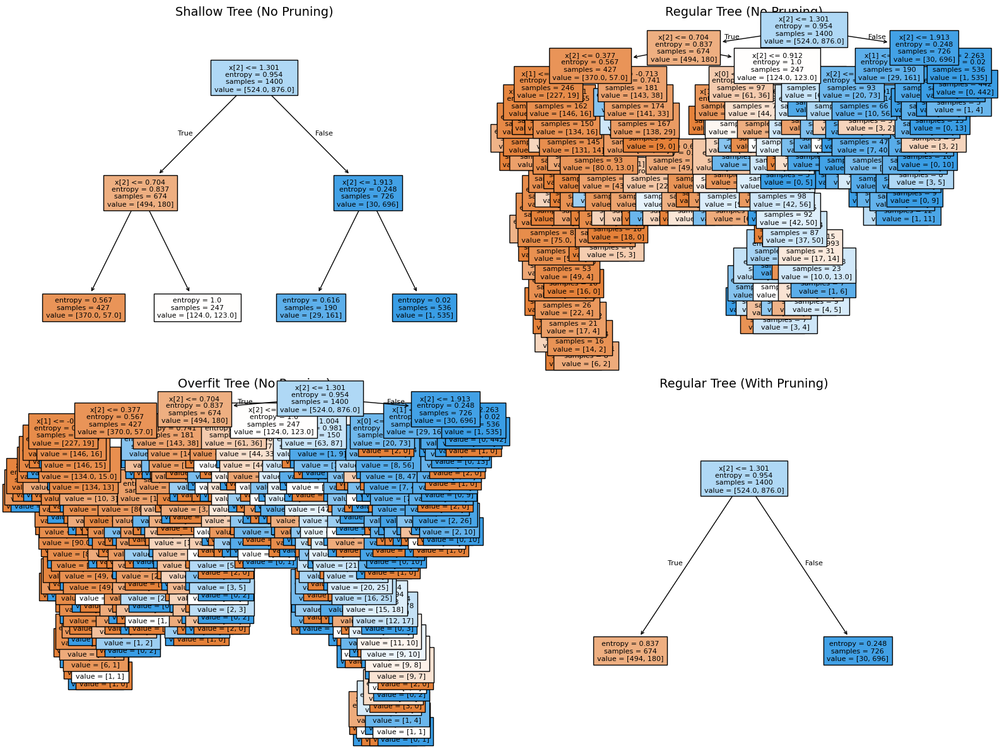

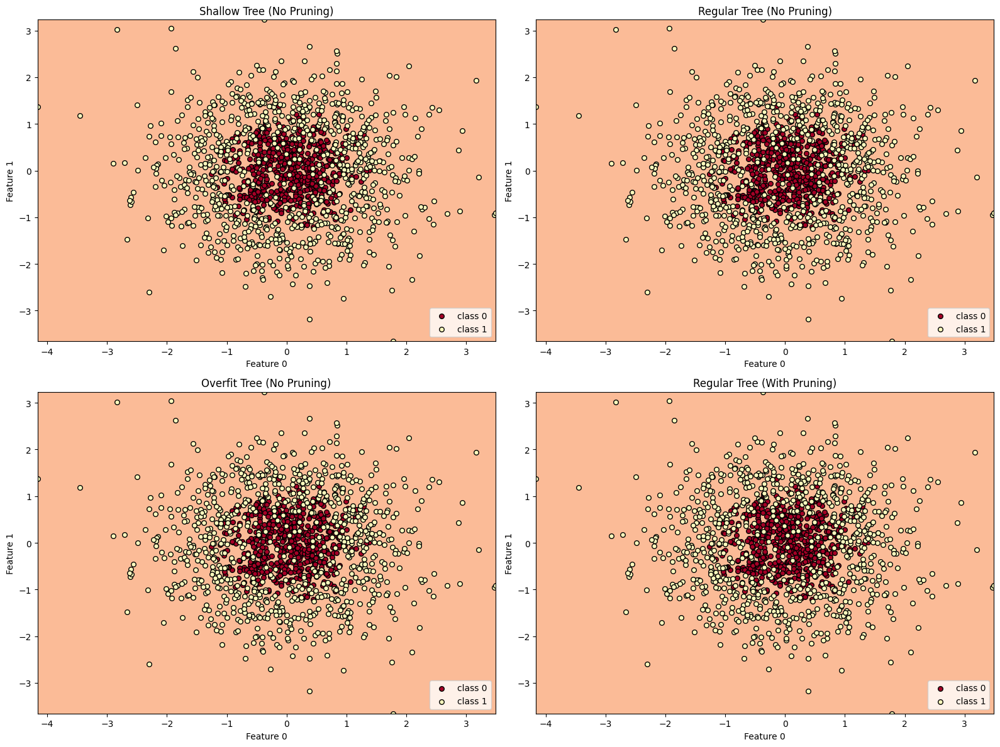

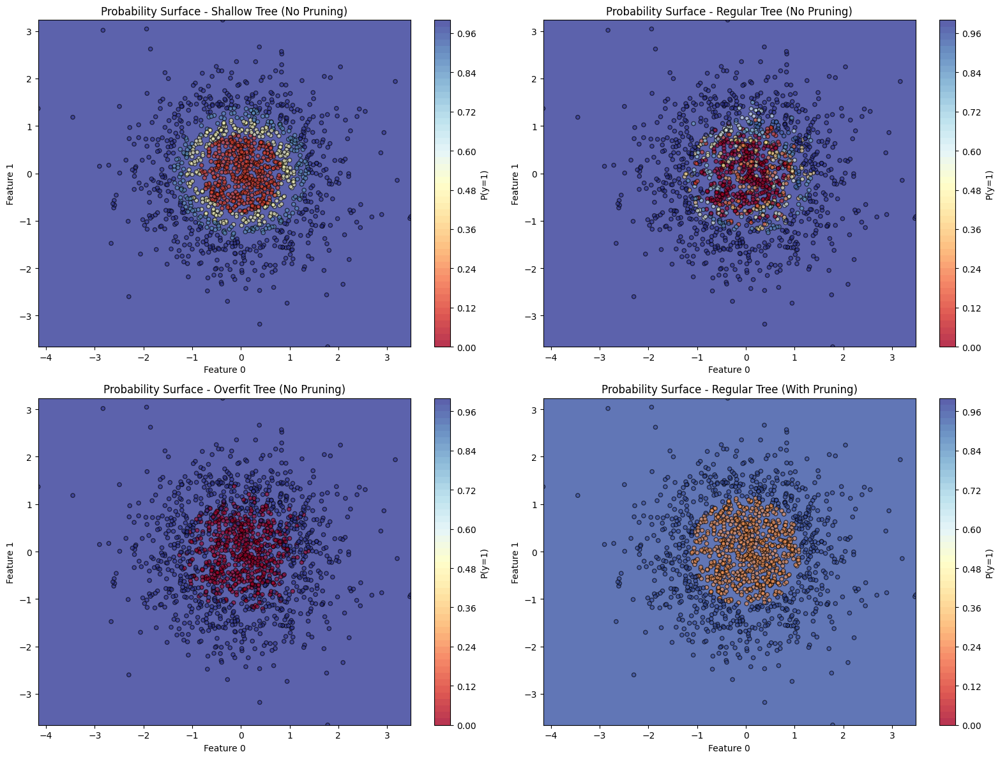

In [19]:
lmt.compare_tree_variants(X_train, X_test, y_train, y_test, lmt, decision=True, prob_surf=True, feature_pair=(0,1))

Shallow Tree (No Pruning) - Accuracy: 0.8567, AUC: 0.9236, Log Loss: 0.3207
Regular Tree (No Pruning) - Accuracy: 0.8333, AUC: 0.8948, Log Loss: 2.0919
Overfit Tree (No Pruning) - Accuracy: 0.8083, AUC: 0.7919, Log Loss: 6.9084
Regular Tree (With Pruning) - Accuracy: 0.8567, AUC: 0.8767, Log Loss: 0.3518


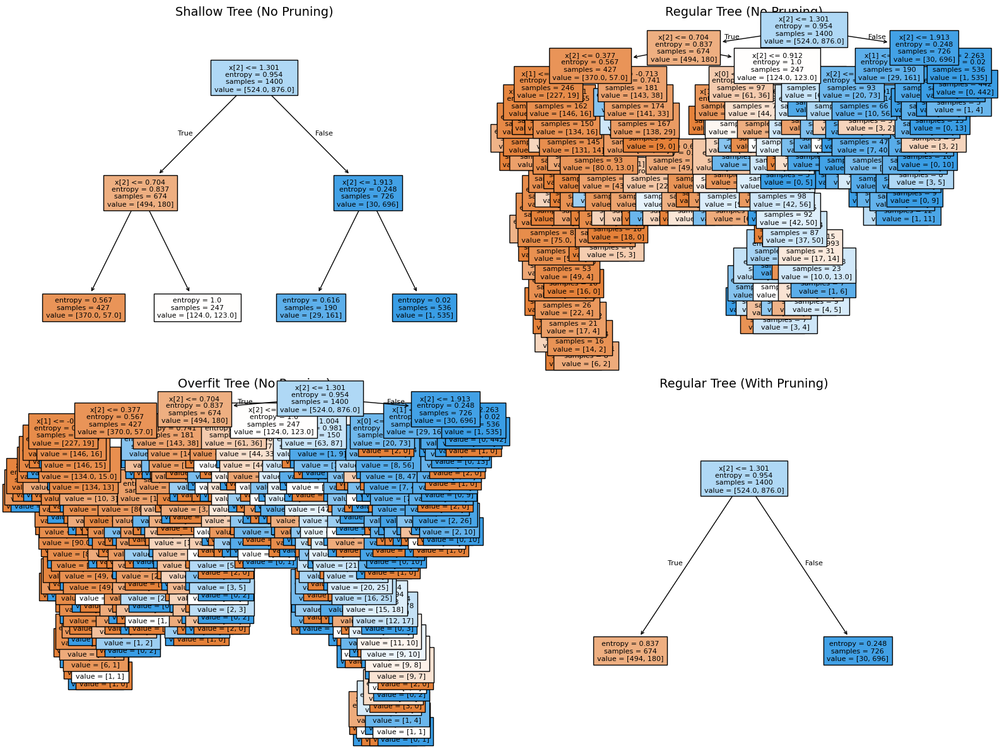

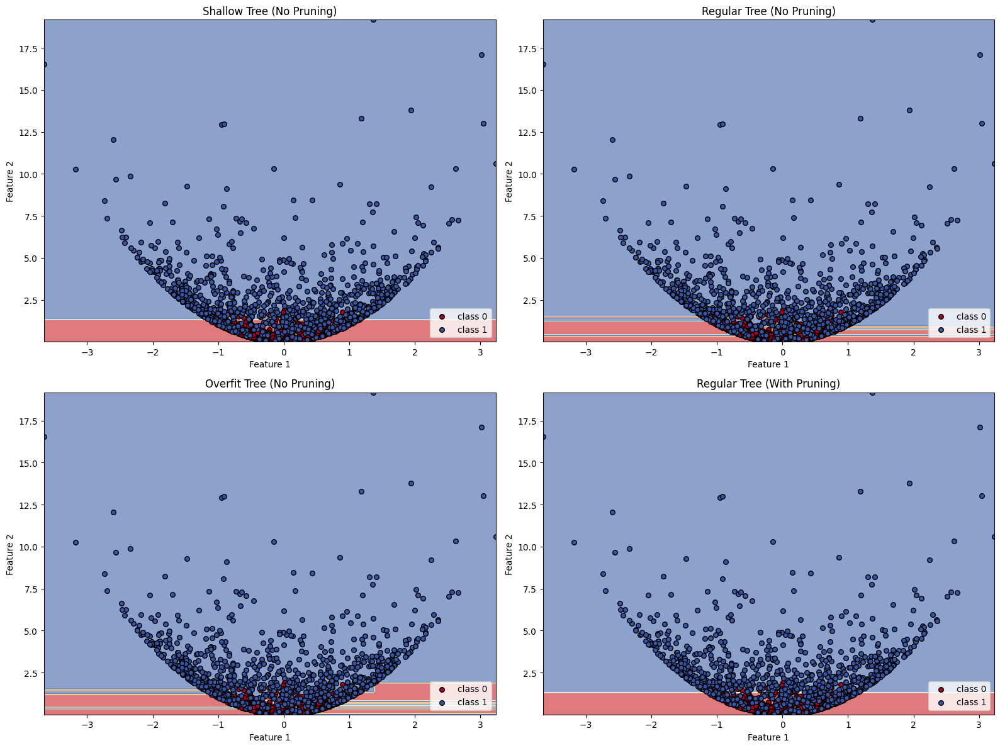

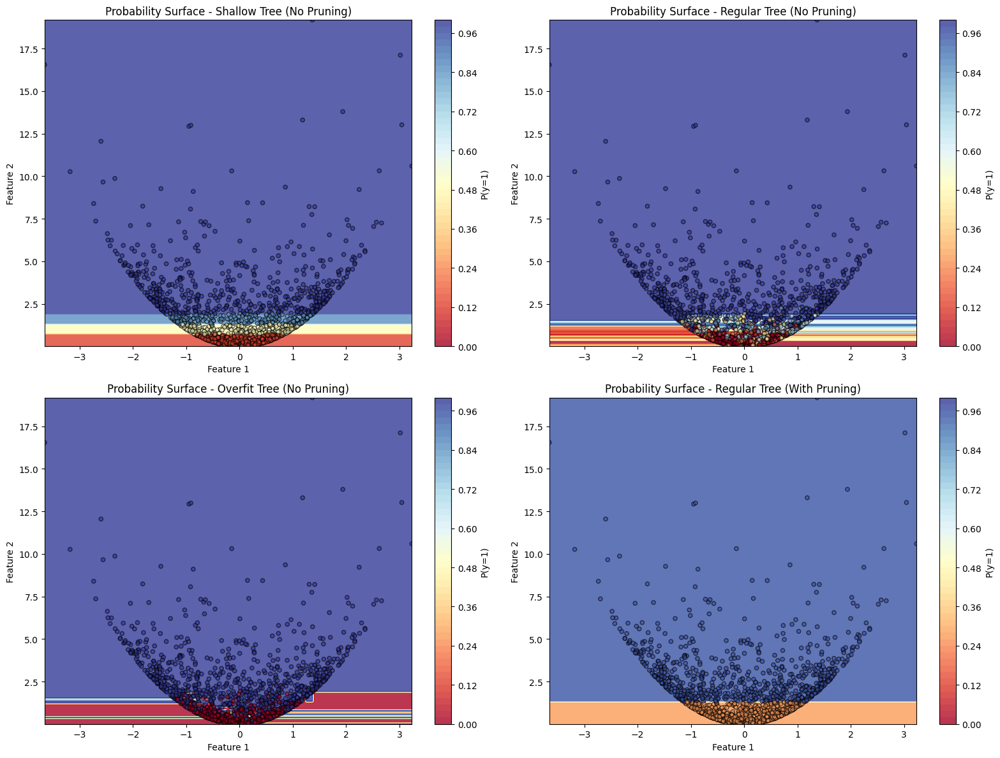

In [20]:
lmt.compare_tree_variants(X_train, X_test, y_train, y_test, lmt, decision=True, prob_surf=True, feature_pair=(1,2))

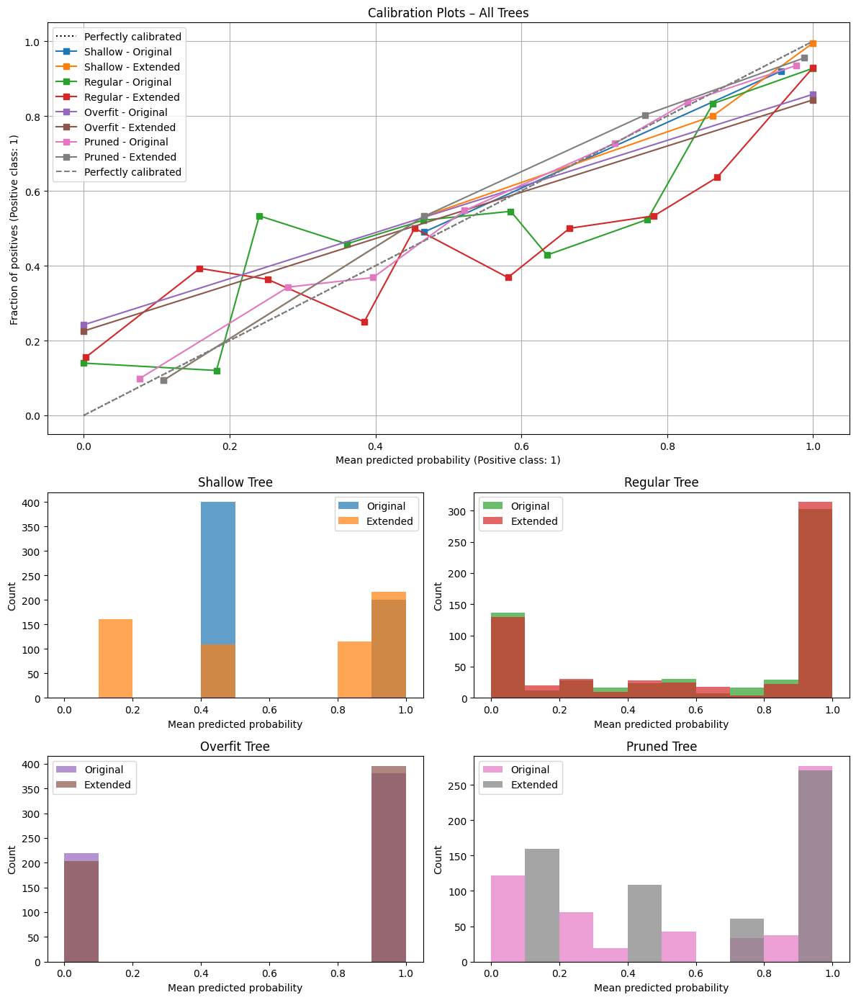

In [9]:
clf_shallow     = lmt.construct_tree(X_train[:,:2],     y_train,     size='shallow', pruning=False)
clf_regular     = lmt.construct_tree(X_train[:,:2],     y_train,     size='regular', pruning=False)
clf_overfit     = lmt.construct_tree(X_train[:,:2],     y_train,     size='overfit', pruning=False)
clf_pruned      = lmt.construct_tree(X_train[:,:2],     y_train,     size='regular', pruning=True)

clf_shallow_ext = lmt.construct_tree(X_train, y_train, size='shallow', pruning=False)
clf_regular_ext = lmt.construct_tree(X_train, y_train, size='regular', pruning=False)
clf_overfit_ext = lmt.construct_tree(X_train, y_train, size='overfit', pruning=False)
clf_pruned_ext  = lmt.construct_tree(X_train, y_train, size='regular', pruning=True)

# Call the plotting function
calibration.plot_combined_calibration_and_hists(
    y_test=y_test,
    X_test=X_test[:, :2],
    y_test_ext=y_test,
    X_test_ext=X_test,
    clf_orig_list=[clf_shallow, clf_regular, clf_overfit, clf_pruned],
    clf_ext_list=[clf_shallow_ext, clf_regular_ext, clf_overfit_ext, clf_pruned_ext],
)

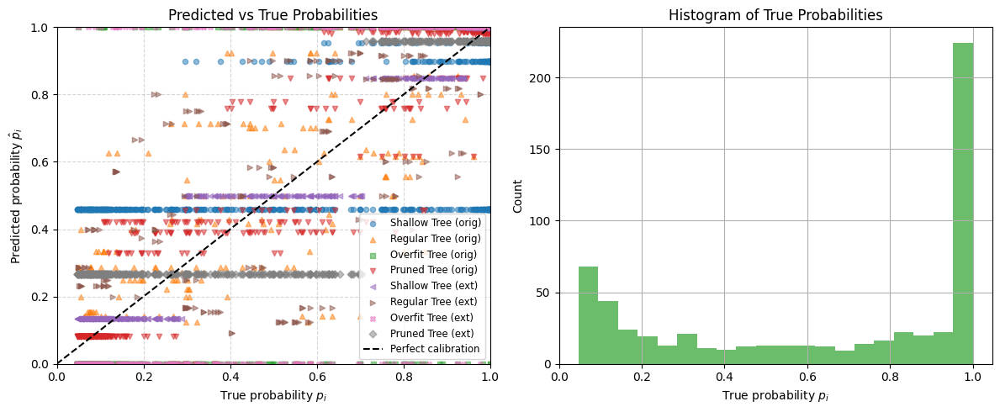

In [22]:
models = {
    "Shallow Tree (orig)": clf_shallow,
    "Regular Tree (orig)": clf_regular,
    "Overfit Tree (orig)": clf_overfit,
    "Pruned Tree (orig)": clf_pruned,
    "Shallow Tree (ext)": clf_shallow_ext,
    "Regular Tree (ext)": clf_regular_ext,
    "Overfit Tree (ext)": clf_overfit_ext,
    "Pruned Tree (ext)": clf_pruned_ext,
}

p_true = expit(alpha * (X_test[:, 0]**2 + X_test[:, 1]**2 - r0))

calibration.plot_pred_vs_true(
    models=models,
    p_true=p_true,
    X_test=X_test,
    model_type='tree',
    orig_cols=2,
    figsize=(12, 5)
)

Quantile edges: [0.     0.1094 0.4667 1.     1.     1.    ]


C:\Users\allis\AppData\Local\Temp\ipykernel_6564\1685368812.py:20: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = mpl.cm.get_cmap(cmap_name, nq)


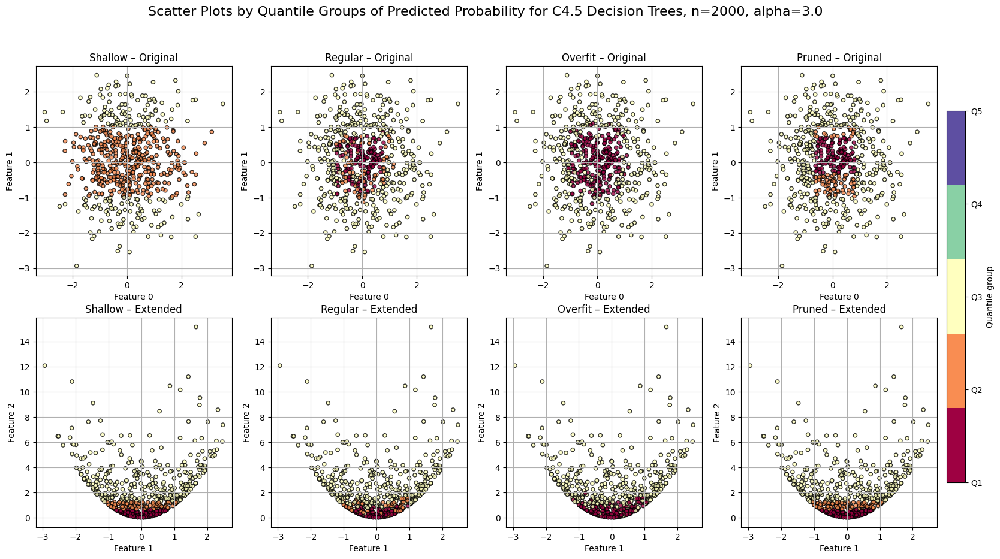

In [16]:
# Step 1: Get predicted probabilities from all models
all_probas = []

for clf in [clf_shallow, clf_regular, clf_overfit, clf_pruned]:
    y_proba = clf.predict_proba(X_test[:, :2])[:, 1]
    all_probas.append(y_proba)

for clf in [clf_shallow_ext, clf_regular_ext, clf_overfit_ext, clf_pruned_ext]:
    y_proba = clf.predict_proba(X_test)[:, 1]
    all_probas.append(y_proba)

all_probas = np.concatenate(all_probas)

# Step 2: Define consistent binning, norm, and colormap
nq = 5
q_edges = np.quantile(all_probas, np.linspace(0, 1, nq + 1))
print("Quantile edges:", np.round(q_edges, 4))
norm = mpl.colors.Normalize(vmin=0, vmax=nq - 1)
cmap_name = 'Spectral'
cmap = mpl.cm.get_cmap(cmap_name, nq)
model_labels = ["Shallow", "Regular", "Overfit", "Pruned"]

# Step 3: Create subplots
fig, axes = plt.subplots(nrows=2, ncols=4, figsize=(20, 10))

# Top row: original (X_test[:, :2])
for idx, clf in enumerate([clf_shallow, clf_regular, clf_overfit, clf_pruned]):
    y_proba = clf.predict_proba(X_test[:, :2])[:, 1]
    ax = axes[0, idx]
    calibration.plot_scatter_by_quantile(
        X_test[:, :2], y_proba,
        n_quantiles=nq,
        title=f"{model_labels[idx]} – Original",
        ax=ax,
        feature_1=0,
        feature_2=1,
        cmap=cmap,
        norm=norm,
        q_edges=q_edges
    )

# Bottom row: extended (predict on full X_test, still plot first 2 dims)
for idx, clf in enumerate([clf_shallow_ext, clf_regular_ext, clf_overfit_ext, clf_pruned_ext]):
    y_proba = clf.predict_proba(X_test)[:, 1]
    ax = axes[1, idx]
    calibration.plot_scatter_by_quantile(
        X_test, y_proba,
        n_quantiles=nq,
        title=f"{model_labels[idx]} – Extended",
        ax=ax,
        feature_1=1,
        feature_2=2,
        cmap=cmap,
        norm=norm,
        q_edges=q_edges
    )


# Step 4: Shared colorbar
sm = mpl.cm.ScalarMappable(norm=norm, cmap=cmap)
sm.set_array([])

cbar = fig.colorbar(
    sm,
    ax=axes,
    orientation='vertical',
    fraction=0.02,
    pad=0.01
)
cbar.set_label("Quantile group")
cbar.set_ticks(np.arange(nq))
cbar.set_ticklabels([f"Q{i + 1}" for i in range(nq)])

fig.suptitle(f"Scatter Plots by Quantile Groups of Predicted Probability for C4.5 Decision Trees, n={n}, alpha={alpha}", fontsize=16)
plt.show()

### LMT Version 1

In [24]:
from tqdm import tqdm
import time

original_models = []

configs = [
    ('shallow', False, "shallow (original)"),
    ('regular', False, "regular (original)"),
    ('overfit', False, "overfit (original)"),
    ('regular', True,  "pruned (original)")
]

for size, pruning, label in tqdm(configs, desc="Training original models"):
    with tqdm(total=1, desc=f"Training {label}", leave=True) as pbar:
        clf, nodes = lmt.fit_logistic_model_tree(X_train[:, :2], y_train, size=size, pruning=pruning)
        original_models.append((clf, nodes))
        pbar.update(1)
        print(f"{label} done")

Training original models:  25%|██▌       | 1/4 [00:33<01:39, 33.33s/it]

shallow (original) done


Training original models:  50%|█████     | 2/4 [11:59<13:55, 417.63s/it]

regular (original) done


Training original models:  75%|███████▌  | 3/4 [29:40<11:50, 711.00s/it]

overfit (original) done


Training original models: 100%|██████████| 4/4 [32:27<00:00, 487.00s/it]

pruned (original) done


Original Models Evaluation
Shallow Tree (No Pruning) → Accuracy: 0.6950, Log Loss: 0.6396
Regular Tree (No Pruning) → Accuracy: 0.8350, Log Loss: 2.3807
Overfit Tree (No Pruning) → Accuracy: 0.8150, Log Loss: 6.6681
Regular Tree (With Pruning) → Accuracy: 0.8183, Log Loss: 0.7809


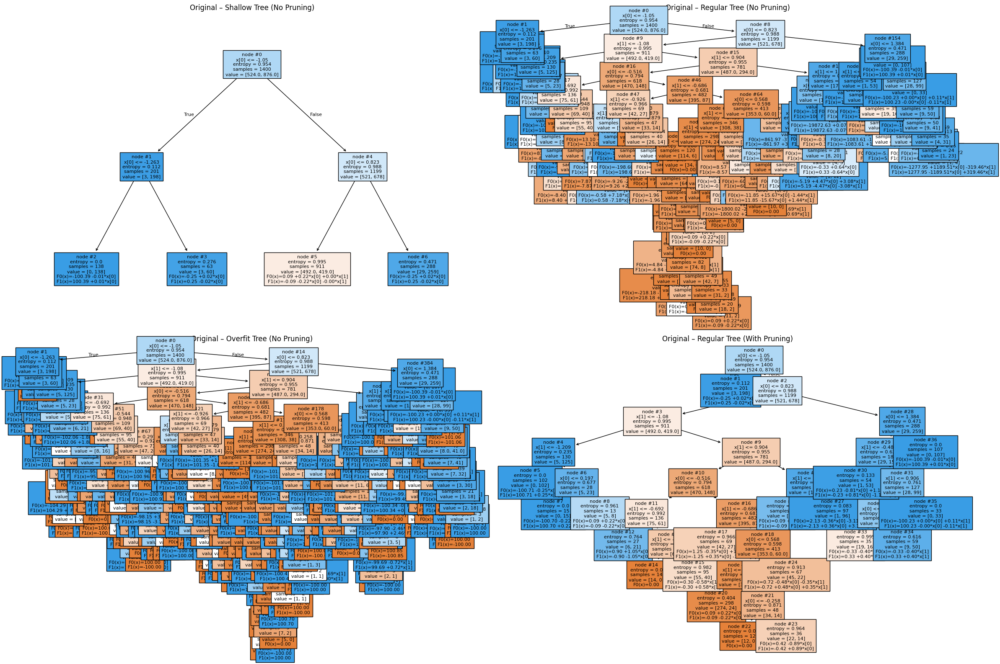

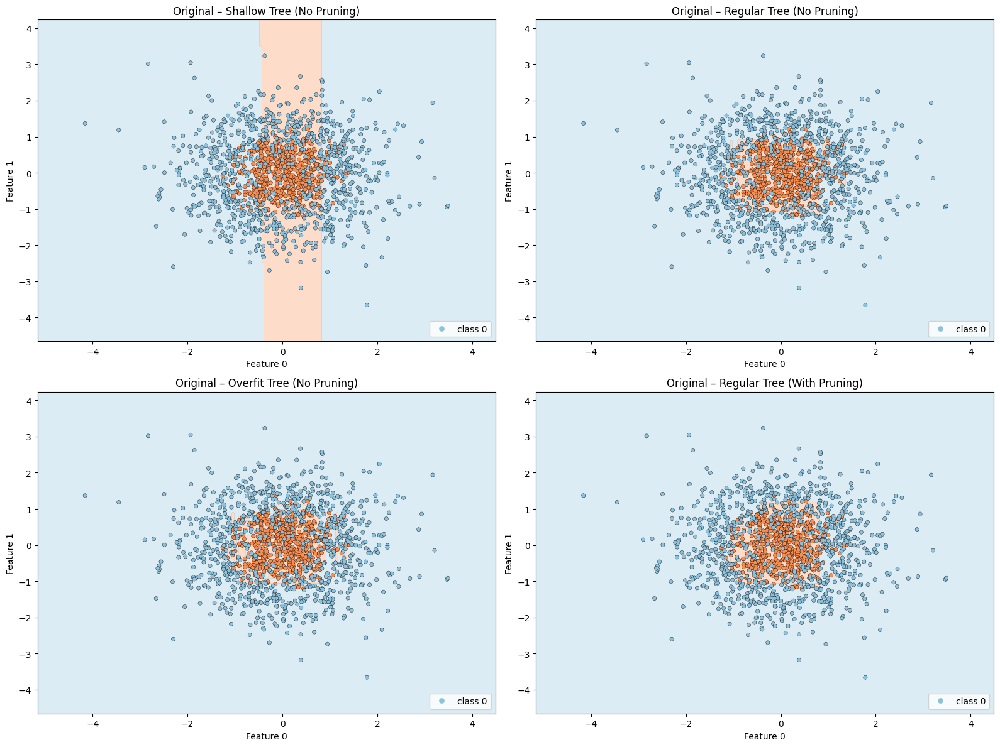

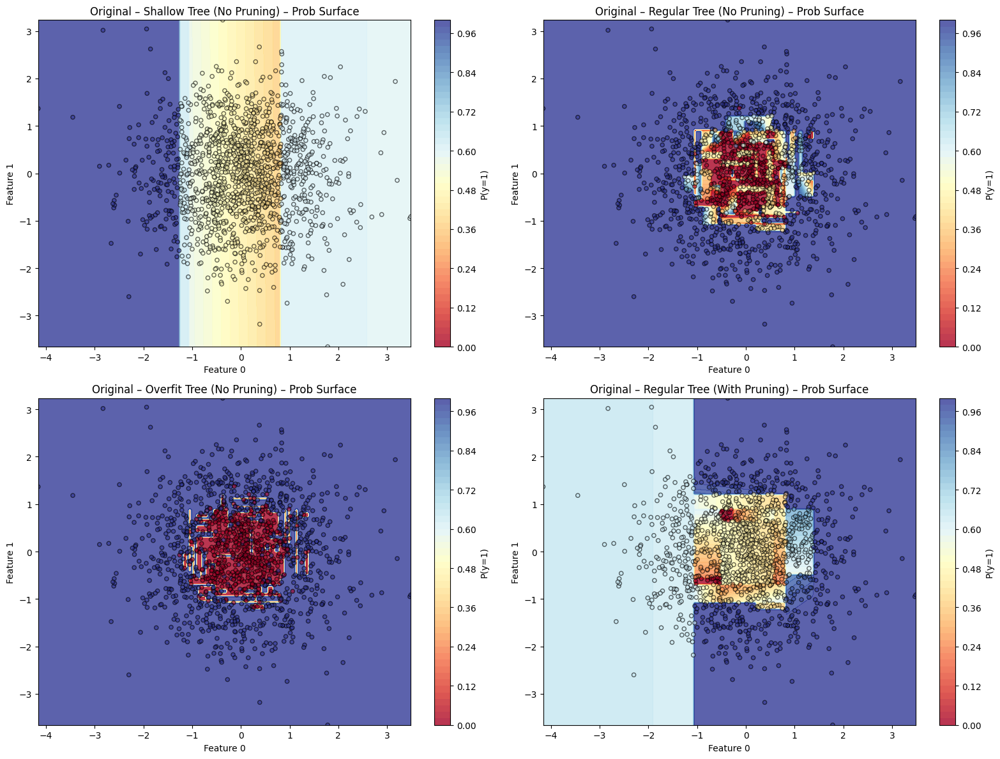

In [25]:
lmt.compare_lmt_variants_multiclass(
    X_train=X_train[:, :2],   # training data used for those models
    X_test=X_test[:, :2],     # must match feature shape
    y_train=y_train,
    y_test=y_test,
    lmt=lmt,
    version='v1',
    decision=True,
    prob_surf=True,
    feature_pair=(0, 1),
    original_models=original_models
)

In [26]:
extended_models = []

configs = [
    ('shallow', False, "shallow (original)"),
    ('regular', False, "regular (original)"),
    ('overfit', False, "overfit (original)"),
    ('regular', True,  "pruned (original)")
]

for size, pruning, label in tqdm(configs, desc="Training extended models"):
    with tqdm(total=1, desc=f"Training {label}", leave=True) as pbar:
        clf, nodes = lmt.fit_logistic_model_tree(X_train, y_train, size=size, pruning=pruning)
        extended_models.append((clf, nodes))
        pbar.update(1)
        print(f"{label} done")

Training extended models:  25%|██▌       | 1/4 [00:43<02:09, 43.18s/it]

shallow (original) done


Training extended models:  50%|█████     | 2/4 [14:45<17:06, 513.37s/it]

regular (original) done


Training extended models:  75%|███████▌  | 3/4 [36:58<14:47, 887.32s/it]

overfit (original) done


Training extended models: 100%|██████████| 4/4 [37:23<00:00, 560.94s/it]

pruned (original) done


Original Models Evaluation
Shallow Tree (No Pruning) → Accuracy: 0.8633, Log Loss: 0.4452
Regular Tree (No Pruning) → Accuracy: 0.8400, Log Loss: 3.3702
Overfit Tree (No Pruning) → Accuracy: 0.8083, Log Loss: 6.9084
Regular Tree (With Pruning) → Accuracy: 0.8633, Log Loss: 0.4189


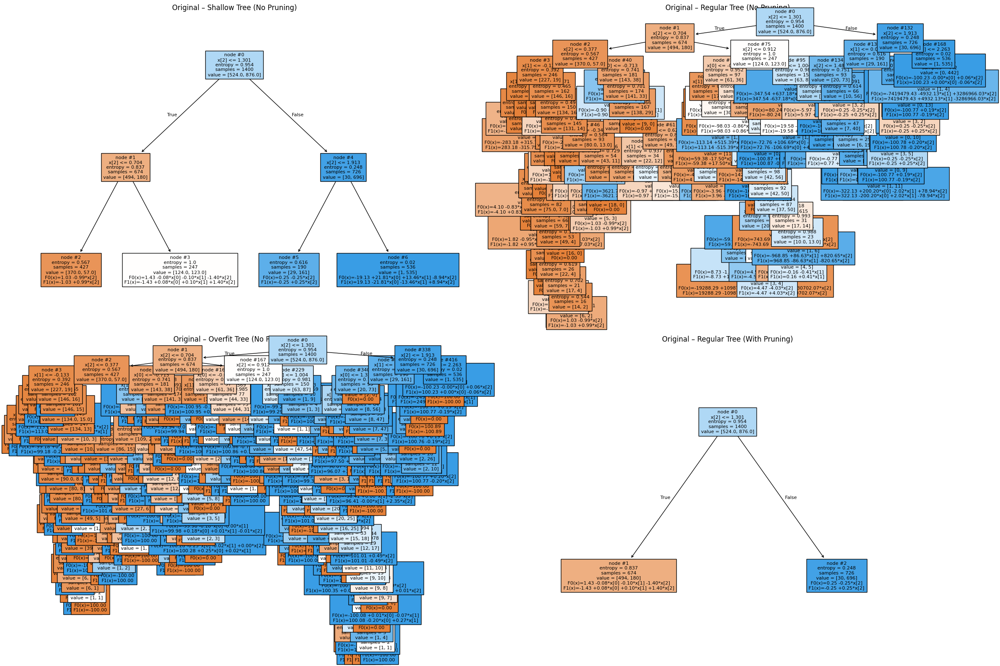

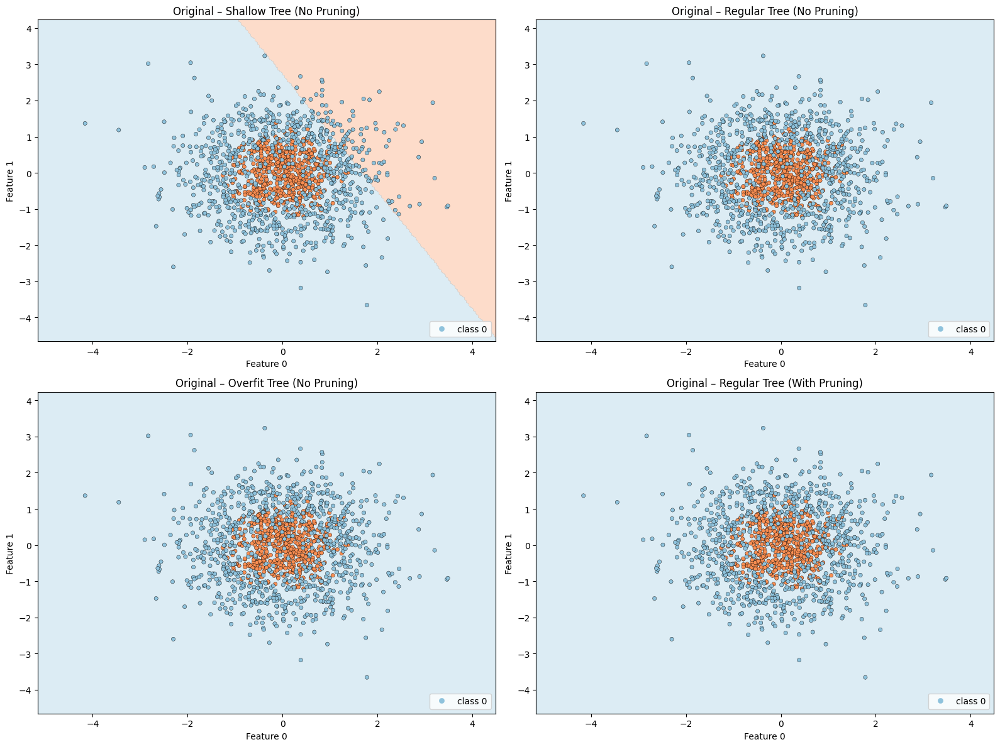

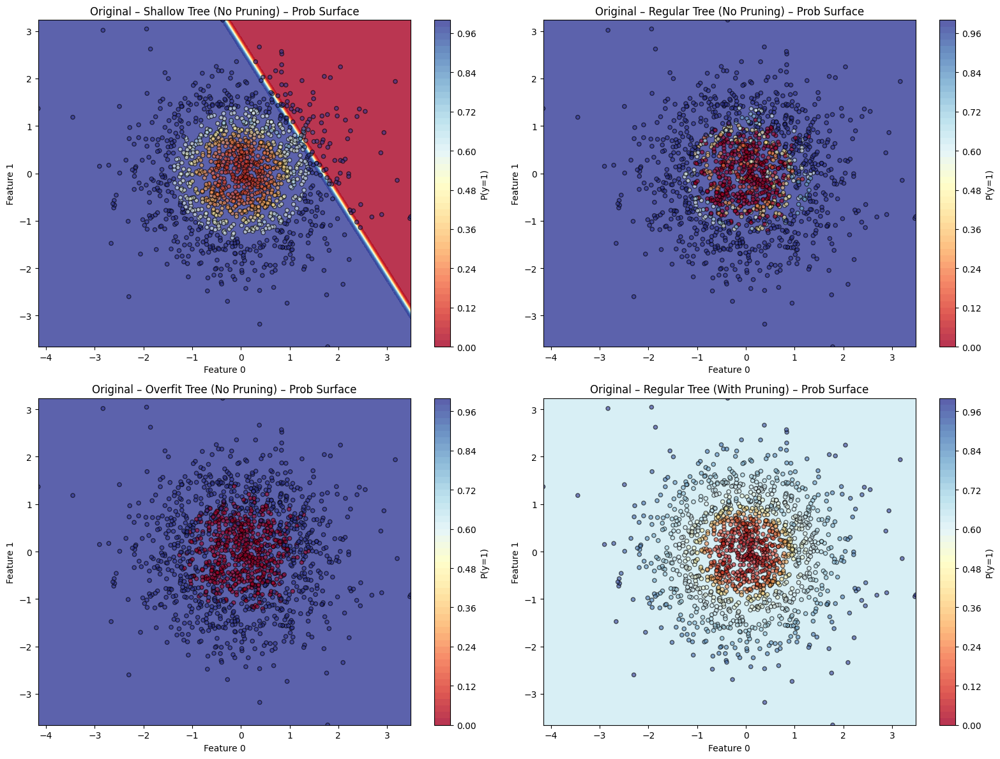

In [27]:
lmt.compare_lmt_variants_multiclass(
    X_train=X_train,   # training data used for those models
    X_test=X_test,     # must match feature shape
    y_train=y_train,
    y_test=y_test,
    lmt=lmt, 
    version='v1',
    decision=True,
    prob_surf=True,
    feature_pair=(0, 1),
    original_models=extended_models
)

Original Models Evaluation
Shallow Tree (No Pruning) → Accuracy: 0.8633, Log Loss: 0.4452
Regular Tree (No Pruning) → Accuracy: 0.8400, Log Loss: 3.3702
Overfit Tree (No Pruning) → Accuracy: 0.8083, Log Loss: 6.9084
Regular Tree (With Pruning) → Accuracy: 0.8633, Log Loss: 0.4189


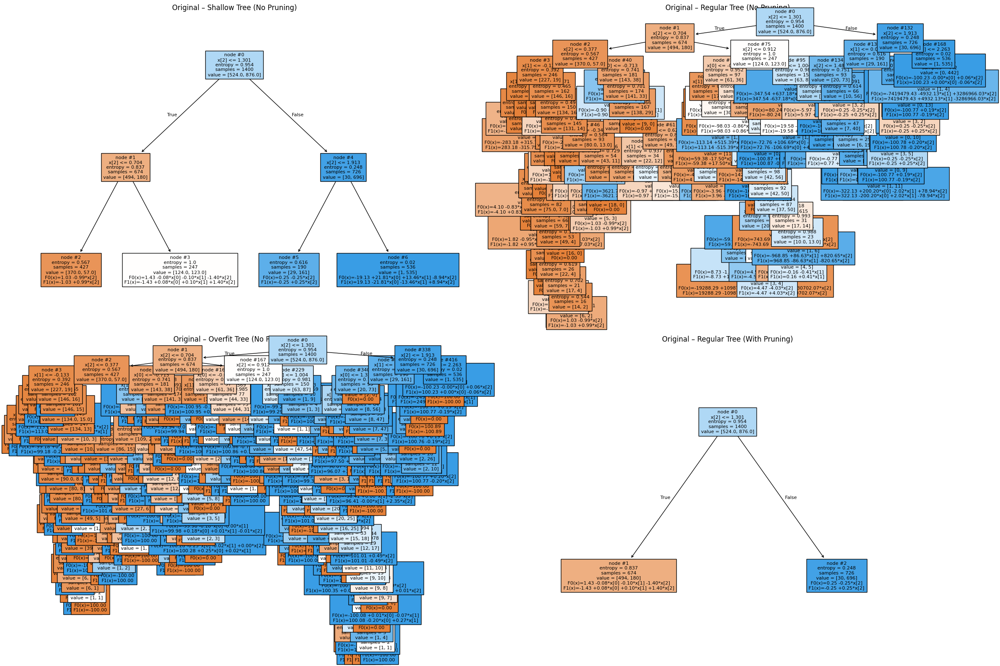

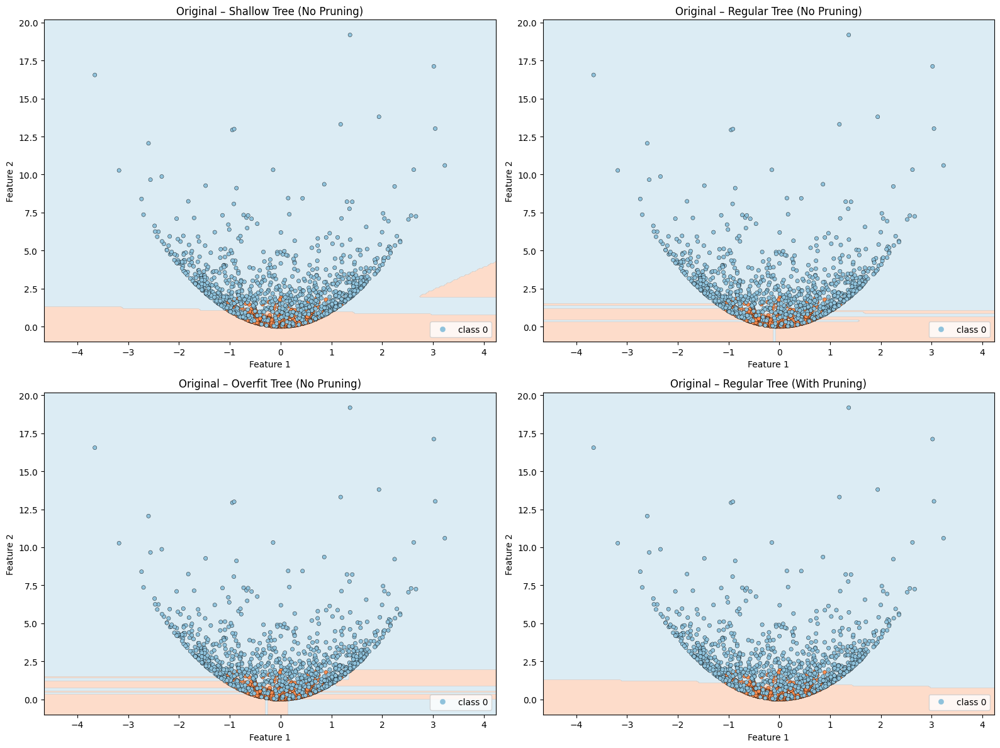

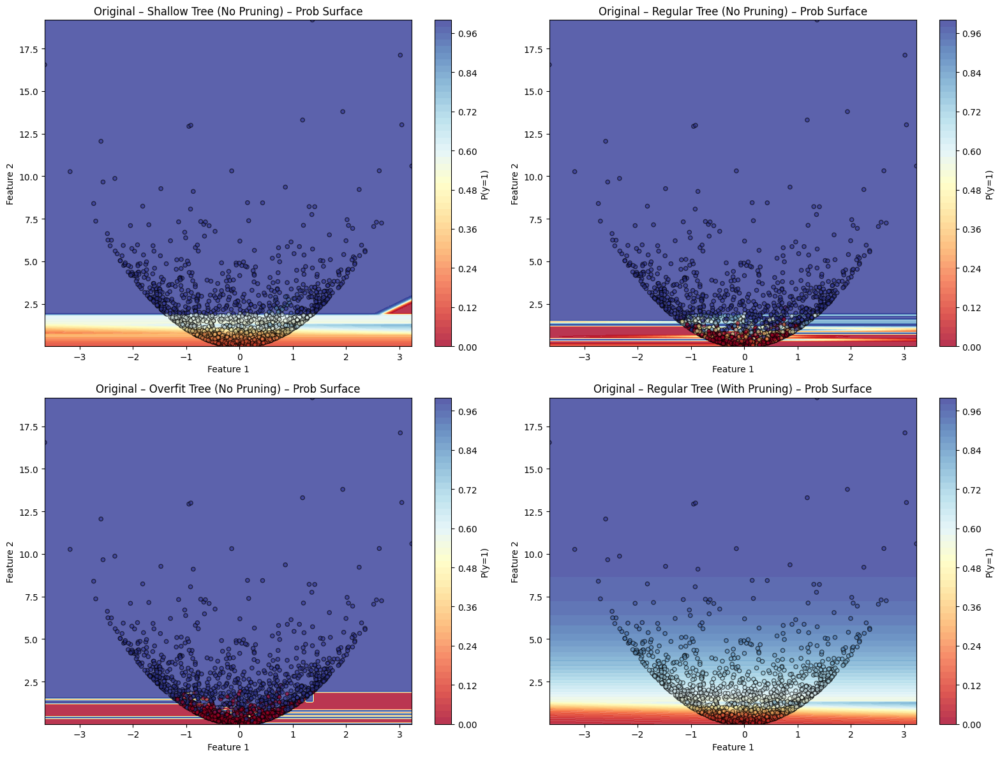

In [28]:
lmt.compare_lmt_variants_multiclass(
    X_train=X_train,   # training data used for those models
    X_test=X_test,     # must match feature shape
    y_train=y_train,
    y_test=y_test,
    lmt=lmt,
    version='v1',
    decision=True,
    prob_surf=True,
    feature_pair=(1, 2),
    original_models=extended_models
)

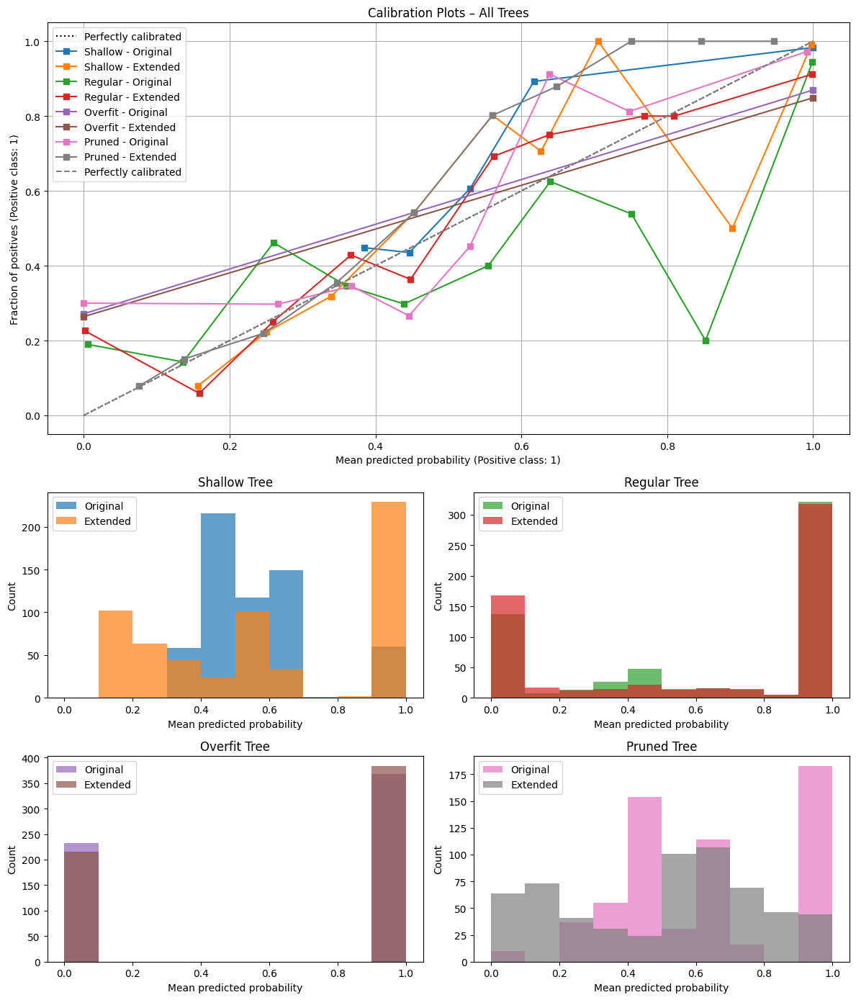

In [29]:
# Call the plotting function
calibration.plot_lmt_combined_calibration_and_hists(
    X_test[:,:2], y_test,
    X_test, y_test,
    clfs=[original_models[0][0], original_models[1][0], original_models[2][0], original_models[3][0]],
    nodes=[original_models[0][1], original_models[1][1], original_models[2][1], original_models[3][1]],
    clfs_ext=[extended_models[0][0], extended_models[1][0], extended_models[2][0], extended_models[3][0]],
    nodes_ext=[extended_models[0][1], extended_models[1][1], extended_models[2][1], extended_models[3][1]],
    model_labels=["Shallow", "Regular", "Overfit", "Pruned"]
)

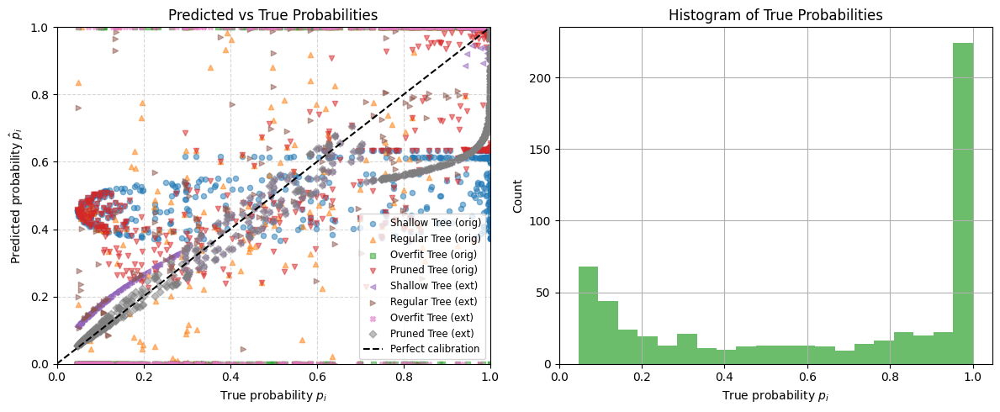

In [30]:
models = {
    "Shallow Tree (orig)": (original_models[0][0], original_models[0][1]),
    "Regular Tree (orig)": (original_models[1][0], original_models[1][1]),
    "Overfit Tree (orig)": (original_models[2][0], original_models[2][1]),
    "Pruned Tree (orig)": (original_models[3][0], original_models[3][1]),
    "Shallow Tree (ext)": (extended_models[0][0], extended_models[0][1]),
    "Regular Tree (ext)": (extended_models[1][0], extended_models[1][1]),
    "Overfit Tree (ext)": (extended_models[2][0], extended_models[2][1]),
    "Pruned Tree (ext)": (extended_models[3][0], extended_models[3][1]),
}

p_true = expit(alpha * (X_test[:, 0]**2 + X_test[:, 1]**2 - r0))

calibration.plot_pred_vs_true(
    models=models,
    p_true=p_true,
    X_test=X_test,
    model_type='lmt',
    orig_cols=2,
    figsize=(12, 5)
)

C:\Users\allis\AppData\Local\Temp\ipykernel_7224\4048578742.py:25: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = mpl.cm.get_cmap(cmap_name, nq)


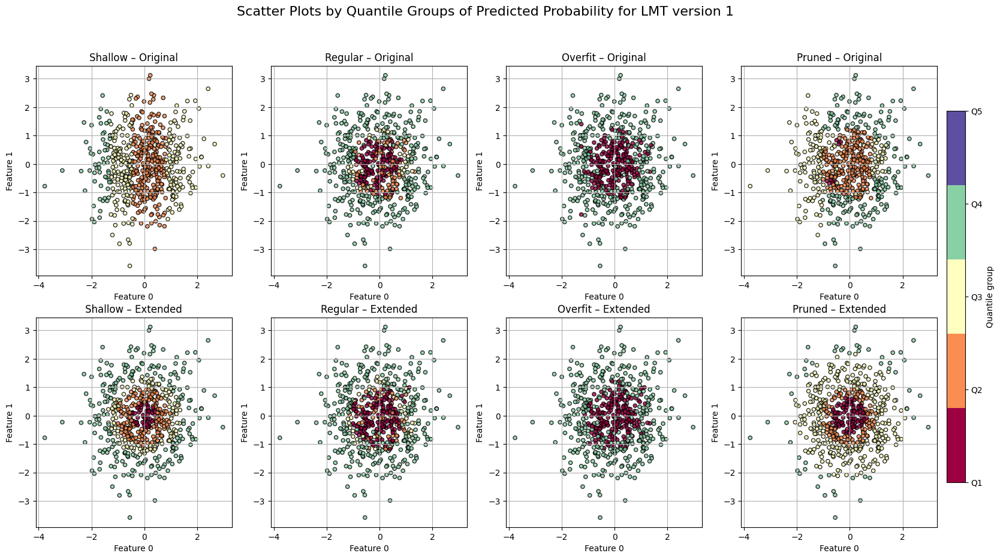

In [31]:
# Step 1: Get predicted probabilities from all models
all_probas = []

for (clf, nodes) in zip(
                                [original_models[0][0], original_models[1][0], original_models[2][0], original_models[3][0]],
                                [original_models[0][1], original_models[1][1], original_models[2][1], original_models[3][1]]
    ):
    y_proba = lmt.predict_proba_lmt_multiclass(X_test[:, :2], clf, nodes)[:, 1]
    all_probas.append(y_proba)

for (clf, nodes) in zip(
                                [extended_models[0][0], extended_models[1][0], extended_models[2][0], extended_models[3][0]],
                                [extended_models[0][1], extended_models[1][1], extended_models[2][1], extended_models[3][1]]
    ):
    y_proba = lmt.predict_proba_lmt_multiclass(X_test, clf, nodes)[:, 1]
    all_probas.append(y_proba)

all_probas = np.concatenate(all_probas)

# Step 2: Define consistent binning, norm, and colormap
nq = 5
q_edges = np.quantile(all_probas, np.linspace(0, 1, nq + 1))
norm = mpl.colors.Normalize(vmin=0, vmax=nq - 1)
cmap_name = 'Spectral'
cmap = mpl.cm.get_cmap(cmap_name, nq)
model_labels = ["Shallow", "Regular", "Overfit", "Pruned"]

# Step 3: Create subplots
fig, axes = plt.subplots(nrows=2, ncols=4, figsize=(20, 10))

# Top row: original (X_test[:, :2])
for idx, (clf, nodes) in enumerate(zip(
                                [original_models[0][0], original_models[1][0], original_models[2][0], original_models[3][0]],
                                [original_models[0][1], original_models[1][1], original_models[2][1], original_models[3][1]]
    )):
    y_proba = lmt.predict_proba_lmt_multiclass(X_test[:, :2], clf, nodes)[:, 1]
    ax = axes[0, idx]
    calibration.plot_scatter_by_quantile(
        X_test[:, :2], y_proba,
        n_quantiles=nq,
        title=f"{model_labels[idx]} – Original",
        ax=ax,
        feature_1=0,
        feature_2=1,
        cmap=cmap,
        norm=norm,
        q_edges=q_edges
    )

# Bottom row: extended (predict on full X_test, still plot first 2 dims)
for idx, (clf, nodes) in enumerate(zip(
                                [extended_models[0][0], extended_models[1][0], extended_models[2][0], extended_models[3][0]],
                                [extended_models[0][1], extended_models[1][1], extended_models[2][1], extended_models[3][1]]
    )):
    y_proba = lmt.predict_proba_lmt_multiclass(X_test, clf, nodes)[:, 1]
    ax = axes[1, idx]
    calibration.plot_scatter_by_quantile(
        X_test[:, :2], y_proba,
        n_quantiles=nq,
        title=f"{model_labels[idx]} – Extended",
        ax=ax,
        feature_1=0,
        feature_2=1,
        cmap=cmap,
        norm=norm,
        q_edges=q_edges
    )


# Step 4: Shared colorbar
sm = mpl.cm.ScalarMappable(norm=norm, cmap=cmap)
sm.set_array([])

cbar = fig.colorbar(
    sm,
    ax=axes,
    orientation='vertical',
    fraction=0.02,
    pad=0.01
)
cbar.set_label("Quantile group")
cbar.set_ticks(np.arange(nq))
cbar.set_ticklabels([f"Q{i + 1}" for i in range(nq)])

fig.suptitle("Scatter Plots by Quantile Groups of Predicted Probability for LMT version 1", fontsize=16)
plt.show()

### LMT version 2

In [32]:
from tqdm import tqdm
import time

original_models2 = []

configs = [
    ('shallow', False, "shallow (original)"),
    ('regular', False, "regular (original)"),
    ('overfit', False, "overfit (original)"),
    ('regular', True,  "pruned (original)")
]

for size, pruning, label in tqdm(configs, desc="Training original models"):
    with tqdm(total=1, desc=f"Training {label}", leave=True) as pbar:
        clf2, nodes2 = lmt.fit_logistic_model_tree_v2(X_train[:, :2], y_train, size=size, pruning=pruning)
        original_models2.append((clf2, nodes2))
        pbar.update(1)
        print(f"{label} done")

Training original models:  25%|██▌       | 1/4 [00:06<00:18,  6.26s/it]

shallow (original) done


Training original models:  50%|█████     | 2/4 [00:13<00:13,  6.65s/it]

regular (original) done


Training original models:  75%|███████▌  | 3/4 [00:21<00:07,  7.28s/it]

overfit (original) done


Training original models: 100%|██████████| 4/4 [00:30<00:00,  7.69s/it]

pruned (original) done


Original Models Evaluation
Shallow Tree (No Pruning) → Accuracy: 0.6533, Log Loss: 0.6010
Regular Tree (No Pruning) → Accuracy: 0.8283, Log Loss: 1.5503
Overfit Tree (No Pruning) → Accuracy: 0.8150, Log Loss: 1.3812
Regular Tree (With Pruning) → Accuracy: 0.8350, Log Loss: 0.9822


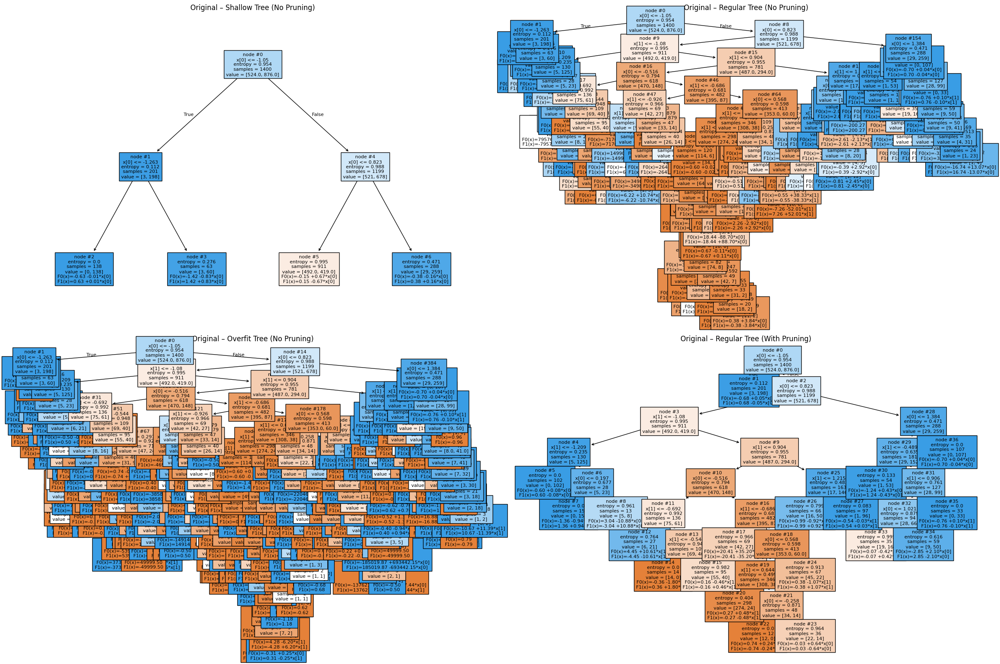

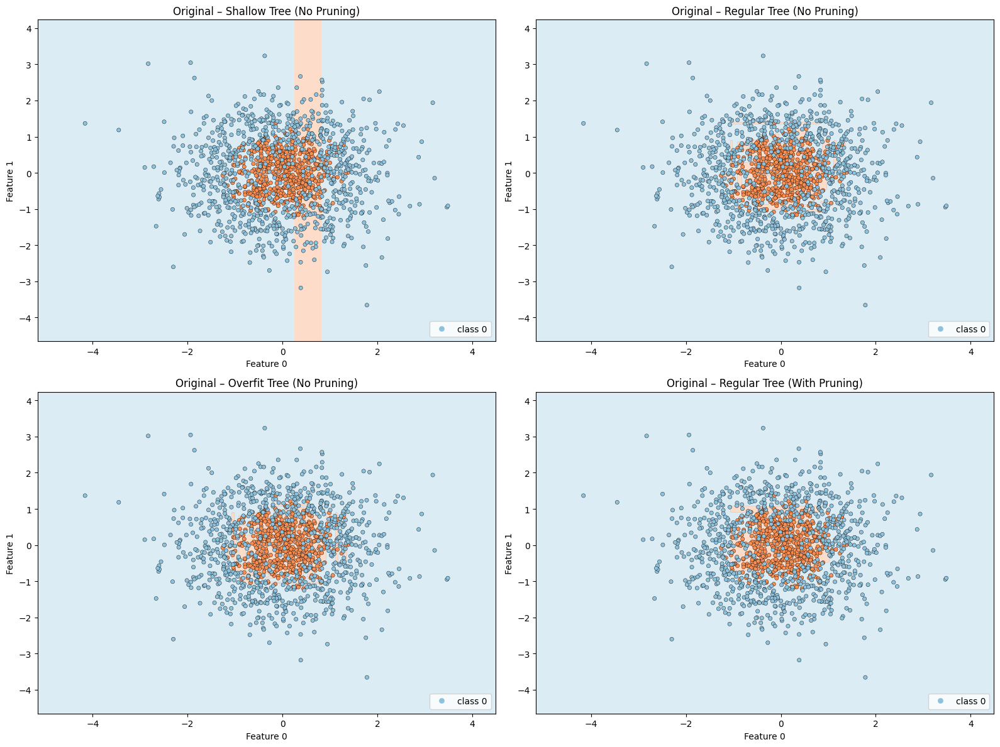

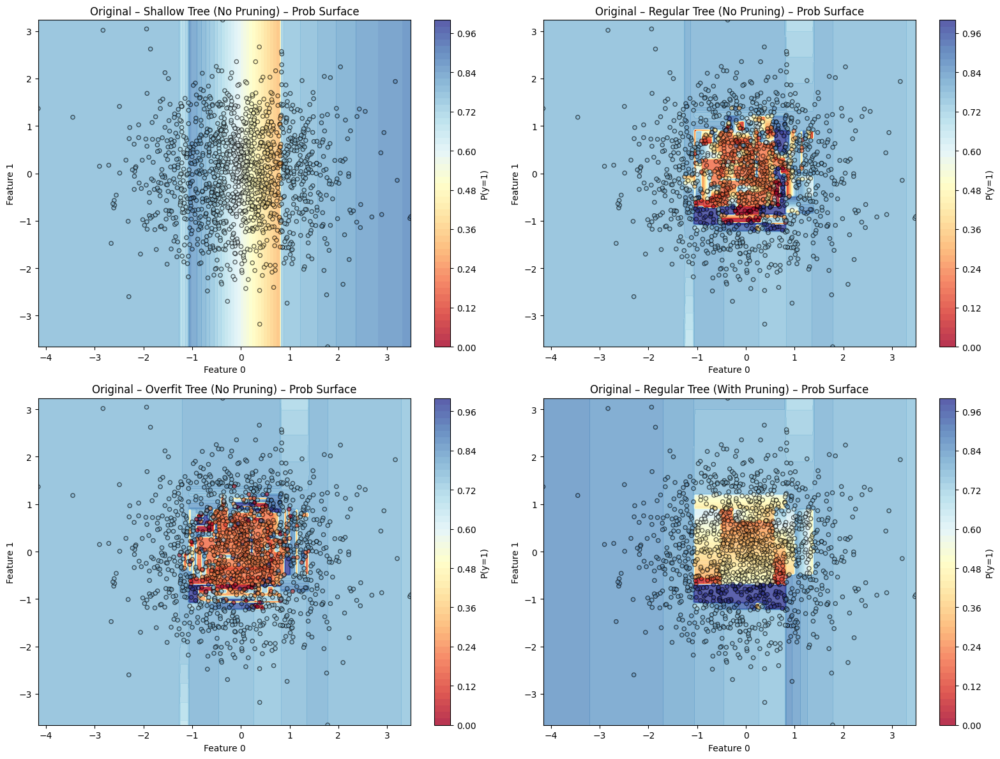

In [33]:
lmt.compare_lmt_variants_multiclass(
    X_train=X_train[:, :2],   # training data used for those models
    X_test=X_test[:, :2],     # must match feature shape
    y_train=y_train,
    y_test=y_test,
    lmt=lmt,
    version='v2',
    decision=True,
    prob_surf=True,
    feature_pair=(0, 1),
    original_models=original_models2
)

In [34]:
extended_models2 = []

configs = [
    ('shallow', False, "shallow (original)"),
    ('regular', False, "regular (original)"),
    ('overfit', False, "overfit (original)"),
    ('regular', True,  "pruned (original)")
]

for size, pruning, label in tqdm(configs, desc="Training extended models"):
    with tqdm(total=1, desc=f"Training {label}", leave=True) as pbar:
        clf2, nodes2 = lmt.fit_logistic_model_tree_v2(X_train, y_train, size=size, pruning=pruning)
        extended_models2.append((clf2, nodes2))
        pbar.update(1)
        print(f"{label} done")

Training extended models:  25%|██▌       | 1/4 [00:08<00:26,  8.68s/it]

shallow (original) done


Training extended models:  50%|█████     | 2/4 [00:17<00:17,  8.89s/it]

regular (original) done


Training extended models:  75%|███████▌  | 3/4 [00:28<00:09,  9.96s/it]

overfit (original) done


Training extended models: 100%|██████████| 4/4 [00:42<00:00, 10.55s/it]

pruned (original) done


Original Models Evaluation
Shallow Tree (No Pruning) → Accuracy: 0.8400, Log Loss: 0.4582
Regular Tree (No Pruning) → Accuracy: 0.8050, Log Loss: 0.5974
Overfit Tree (No Pruning) → Accuracy: 0.8050, Log Loss: 0.8769
Regular Tree (With Pruning) → Accuracy: 0.8717, Log Loss: 0.3951


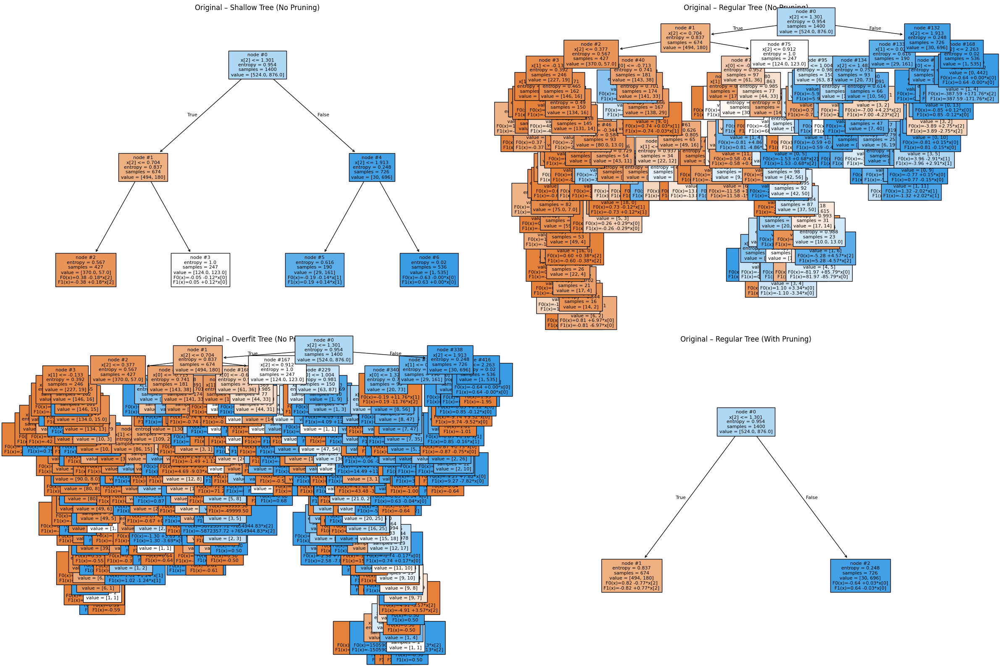

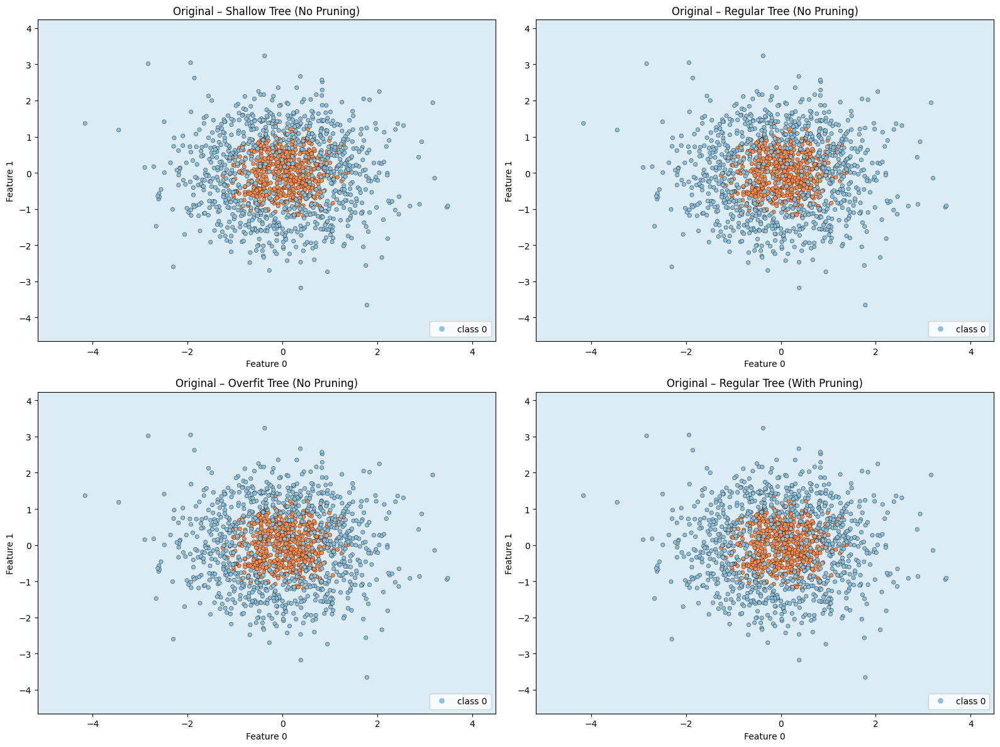

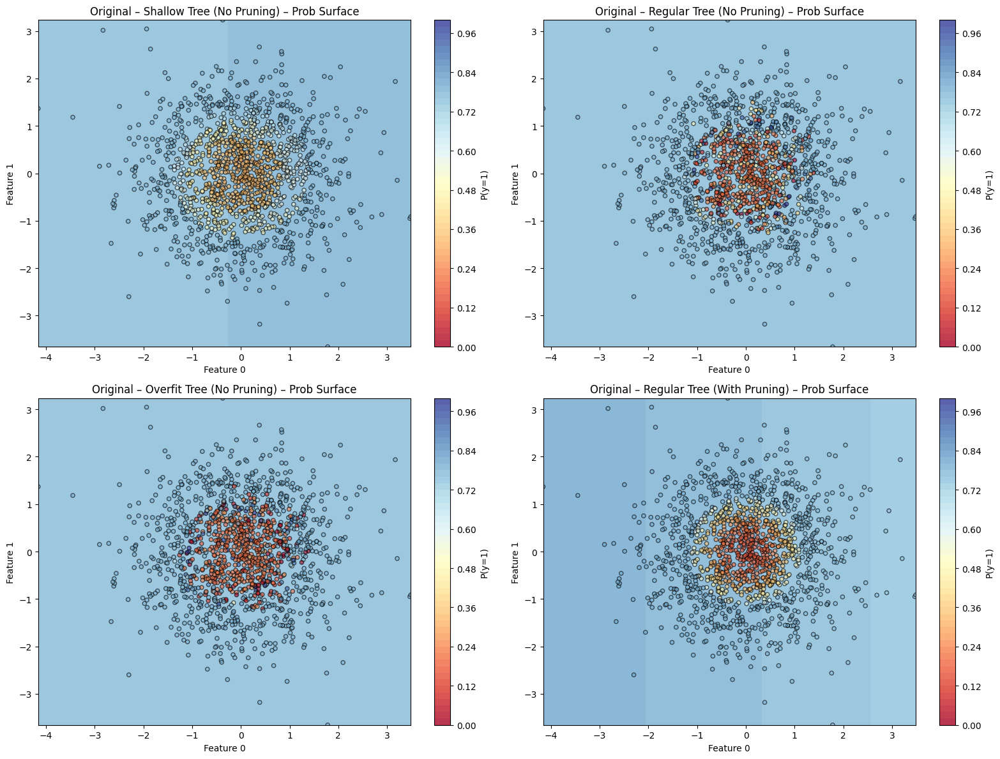

In [35]:
lmt.compare_lmt_variants_multiclass(
    X_train=X_train,   # training data used for those models
    X_test=X_test,     # must match feature shape
    y_train=y_train,
    y_test=y_test,
    lmt=lmt,
    version='v2',
    decision=True,
    prob_surf=True,
    feature_pair=(0, 1),
    original_models=extended_models2
)

Original Models Evaluation
Shallow Tree (No Pruning) → Accuracy: 0.8400, Log Loss: 0.4582
Regular Tree (No Pruning) → Accuracy: 0.8050, Log Loss: 0.5974
Overfit Tree (No Pruning) → Accuracy: 0.8050, Log Loss: 0.8769
Regular Tree (With Pruning) → Accuracy: 0.8717, Log Loss: 0.3951


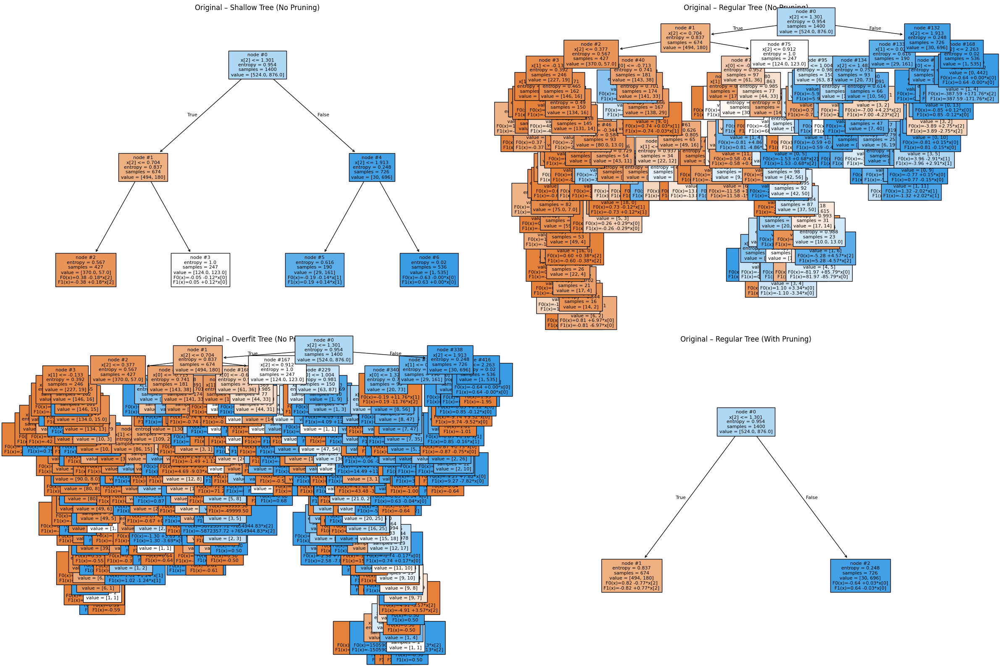

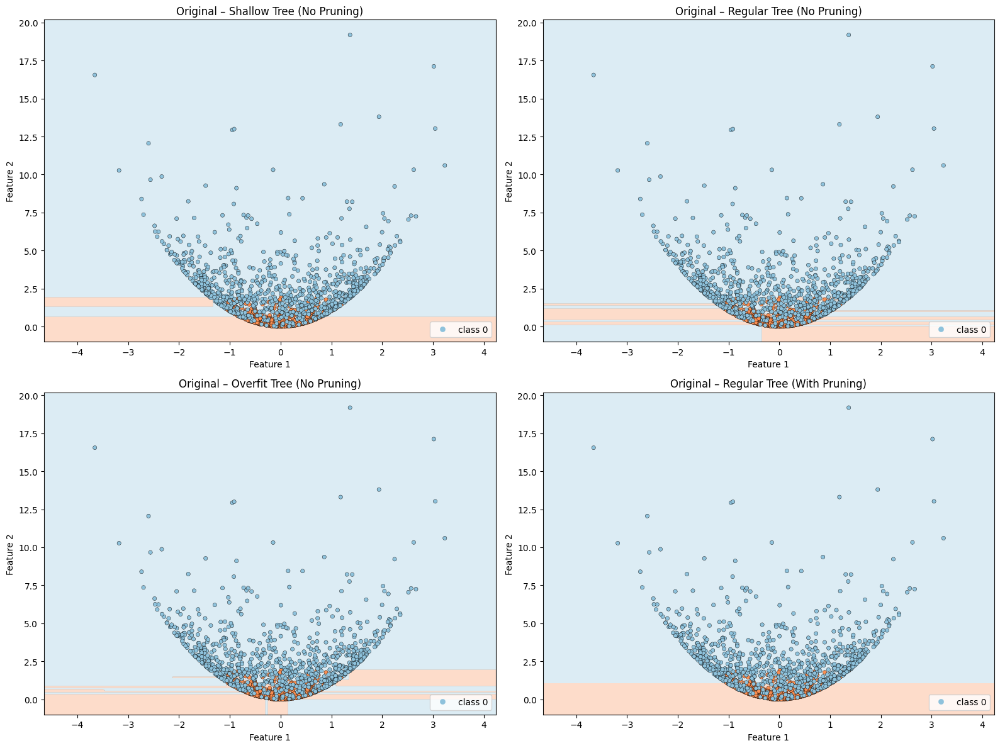

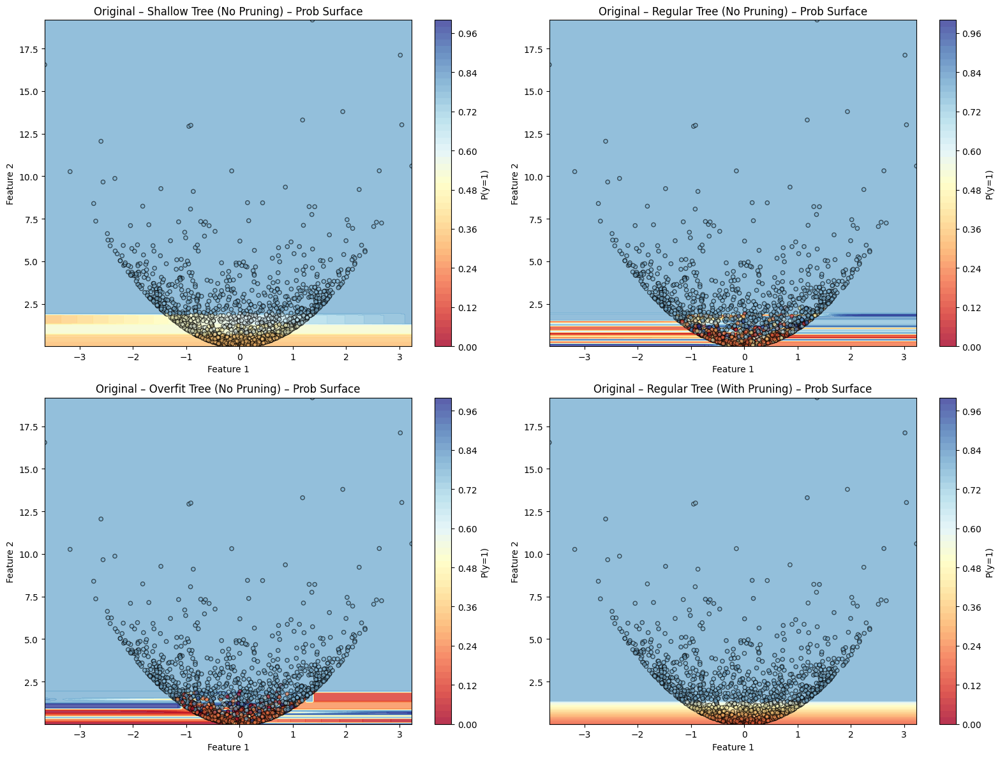

In [36]:
lmt.compare_lmt_variants_multiclass(
    X_train=X_train,   # training data used for those models
    X_test=X_test,     # must match feature shape
    y_train=y_train,
    y_test=y_test,
    lmt=lmt,
    version='v2',
    decision=True,
    prob_surf=True,
    feature_pair=(1, 2),
    original_models=extended_models2
)

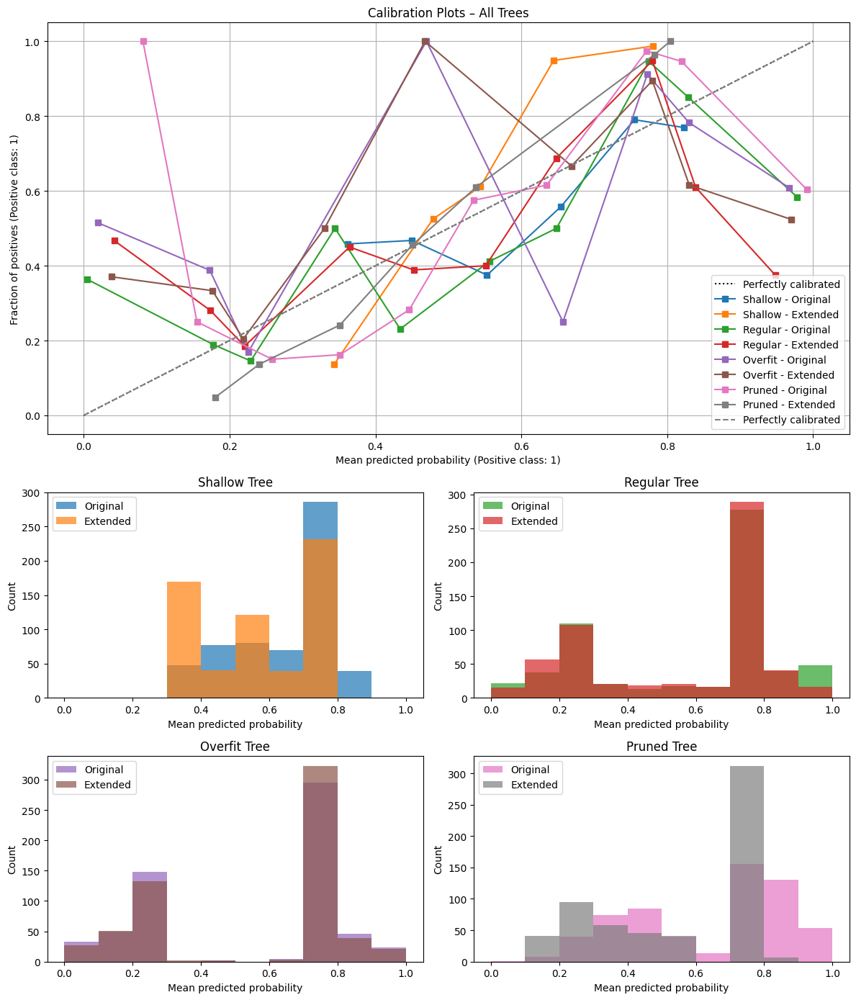

In [37]:
# Call the plotting function
calibration.plot_lmt_combined_calibration_and_hists(
    X_test[:,:2], y_test,
    X_test, y_test,
    clfs=[original_models2[0][0], original_models2[1][0], original_models2[2][0], original_models2[3][0]],
    nodes=[original_models2[0][1], original_models2[1][1], original_models2[2][1], original_models2[3][1]],
    clfs_ext=[extended_models2[0][0], extended_models2[1][0], extended_models2[2][0], extended_models2[3][0]],
    nodes_ext=[extended_models2[0][1], extended_models2[1][1], extended_models2[2][1], extended_models2[3][1]],
    model_labels=["Shallow", "Regular", "Overfit", "Pruned"]
)

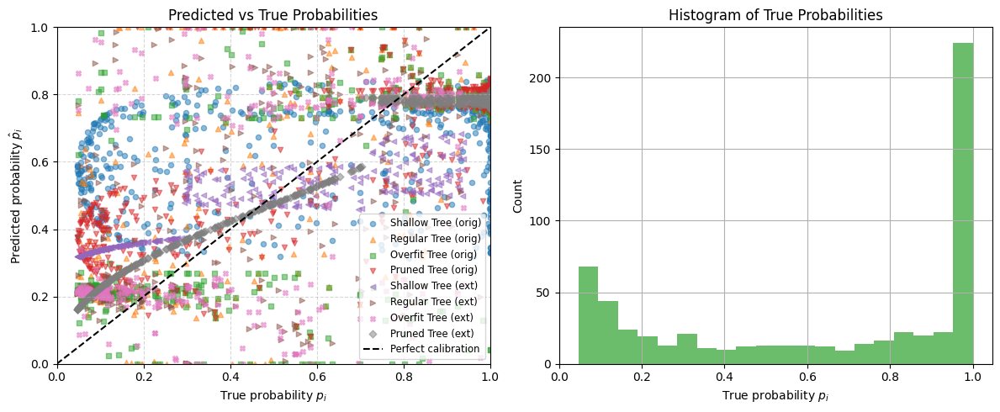

In [38]:
models = {
    "Shallow Tree (orig)": (original_models2[0][0], original_models2[0][1]),
    "Regular Tree (orig)": (original_models2[1][0], original_models2[1][1]),
    "Overfit Tree (orig)": (original_models2[2][0], original_models2[2][1]),
    "Pruned Tree (orig)": (original_models2[3][0], original_models2[3][1]),
    "Shallow Tree (ext)": (extended_models2[0][0], extended_models2[0][1]),
    "Regular Tree (ext)": (extended_models2[1][0], extended_models2[1][1]),
    "Overfit Tree (ext)": (extended_models2[2][0], extended_models2[2][1]),
    "Pruned Tree (ext)": (extended_models2[3][0], extended_models2[3][1]),
}

p_true = expit(alpha * (X_test[:, 0]**2 + X_test[:, 1]**2 - r0))

calibration.plot_pred_vs_true(
    models=models,
    p_true=p_true,
    X_test=X_test,
    model_type='lmt',
    orig_cols=2,
    figsize=(12, 5)
)

C:\Users\allis\AppData\Local\Temp\ipykernel_7224\3910529327.py:25: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = mpl.cm.get_cmap(cmap_name, nq)


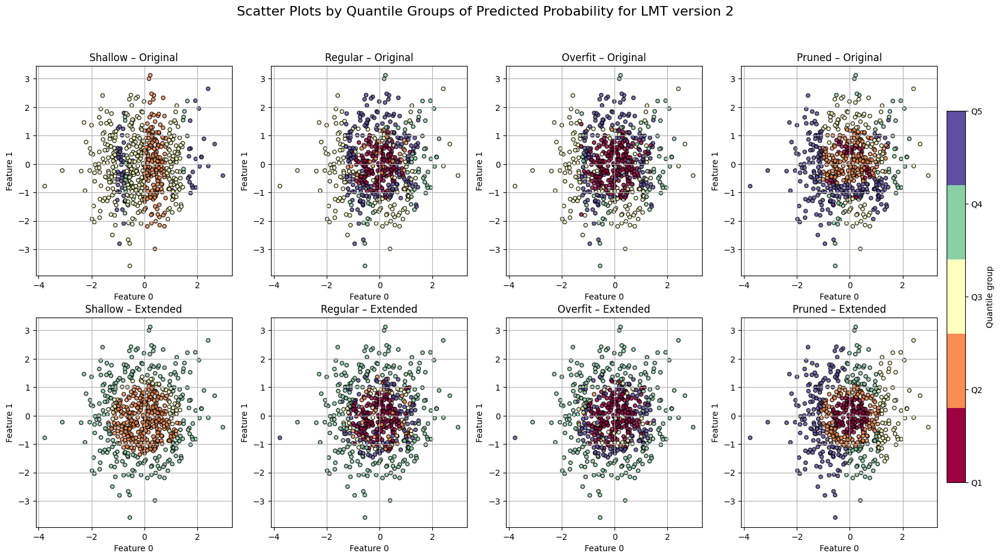

In [39]:
# Step 1: Get predicted probabilities from all models
all_probas = []

for (clf, nodes) in zip(
                                [original_models2[0][0], original_models2[1][0], original_models2[2][0], original_models2[3][0]],
                                [original_models2[0][1], original_models2[1][1], original_models2[2][1], original_models2[3][1]]
    ):
    y_proba = lmt.predict_proba_lmt_multiclass(X_test[:, :2], clf, nodes)[:, 1]
    all_probas.append(y_proba)

for (clf, nodes) in zip(
                                [extended_models2[0][0], extended_models2[1][0], extended_models2[2][0], extended_models2[3][0]],
                                [extended_models2[0][1], extended_models2[1][1], extended_models2[2][1], extended_models2[3][1]]
    ):
    y_proba = lmt.predict_proba_lmt_multiclass(X_test, clf, nodes)[:, 1]
    all_probas.append(y_proba)

all_probas = np.concatenate(all_probas)

# Step 2: Define consistent binning, norm, and colormap
nq = 5
q_edges = np.quantile(all_probas, np.linspace(0, 1, nq + 1))
norm = mpl.colors.Normalize(vmin=0, vmax=nq - 1)
cmap_name = 'Spectral'
cmap = mpl.cm.get_cmap(cmap_name, nq)
model_labels = ["Shallow", "Regular", "Overfit", "Pruned"]

# Step 3: Create subplots
fig, axes = plt.subplots(nrows=2, ncols=4, figsize=(20, 10))

# Top row: original (X_test[:, :2])
for idx, (clf, nodes) in enumerate(zip(
                                [original_models2[0][0], original_models2[1][0], original_models2[2][0], original_models2[3][0]],
                                [original_models2[0][1], original_models2[1][1], original_models2[2][1], original_models2[3][1]]
    )):
    y_proba = lmt.predict_proba_lmt_multiclass(X_test[:, :2], clf, nodes)[:, 1]
    ax = axes[0, idx]
    calibration.plot_scatter_by_quantile(
        X_test[:, :2], y_proba,
        n_quantiles=nq,
        title=f"{model_labels[idx]} – Original",
        ax=ax,
        feature_1=0,
        feature_2=1,
        cmap=cmap,
        norm=norm,
        q_edges=q_edges
    )

# Bottom row: extended (predict on full X_test, still plot first 2 dims)
for idx, (clf, nodes) in enumerate(zip(
                                [extended_models2[0][0], extended_models2[1][0], extended_models2[2][0], extended_models2[3][0]],
                                [extended_models2[0][1], extended_models2[1][1], extended_models2[2][1], extended_models2[3][1]]
    )):
    y_proba = lmt.predict_proba_lmt_multiclass(X_test, clf, nodes)[:, 1]
    ax = axes[1, idx]
    calibration.plot_scatter_by_quantile(
        X_test[:, :2], y_proba,
        n_quantiles=nq,
        title=f"{model_labels[idx]} – Extended",
        ax=ax,
        feature_1=0,
        feature_2=1,
        cmap=cmap,
        norm=norm,
        q_edges=q_edges
    )


# Step 4: Shared colorbar
sm = mpl.cm.ScalarMappable(norm=norm, cmap=cmap)
sm.set_array([])

cbar = fig.colorbar(
    sm,
    ax=axes,
    orientation='vertical',
    fraction=0.02,
    pad=0.01
)
cbar.set_label("Quantile group")
cbar.set_ticks(np.arange(nq))
cbar.set_ticklabels([f"Q{i + 1}" for i in range(nq)])

fig.suptitle("Scatter Plots by Quantile Groups of Predicted Probability for LMT version 2", fontsize=16)
plt.show()